# Figures results

In [1]:
# dependencies
import numpy as np 
import matplotlib.pyplot as plt
import xarray as xr
import cartopy.crs as ccrs

In [2]:
# utils 
def plot_map(lats, lons, data, name,title, cmap='viridis', norm=None):
    plt.figure(figsize=(20, 5))
    # add title
    
    buffer = 0.01
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.set_title(title)
    # Calculate extent with buffer to avoid identical limits
    lon_min, lon_max = lons.min(), lons.max()
    lat_min, lat_max = lats.min(), lats.max()
    extent = [lon_min, lon_max, lat_min, lat_max ]
    
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    ax.coastlines()
    
    # Plot data
    if norm:
        im = ax.imshow(data, origin='lower', extent=[lon_min, lon_max+1.5, lat_min, lat_max], transform=ccrs.PlateCarree(), cmap=cmap, norm=norm)
    else:
        im = ax.imshow(data, origin='lower', extent=[lon_min, lon_max+1.5, lat_min, lat_max], transform=ccrs.PlateCarree(), cmap=cmap)
    plt.colorbar(im, label=name, extend='both')
    ax.gridlines(draw_labels=True)
    plt.show()

def compute_crpss(crps, crps_clim):
    return 1 - np.array(crps) / np.array(crps_clim)
    

# 1. Tables

Put EMOS, RAW, Climato and DRUnet results into same format

## CRPS

In [3]:
# EMOS, raw, climatology
def build_crps_year_dataset(exp_name, variable):
    # compute list of crps, crpss of EMOS, raw, climatology 
    obs_folder = "/home/majanvie/scratch/data/raw/obs"
    crps_emos_list = []
    crps_raw_list = [] 
    crps_clim_list = []

    #forecast_list = []
    for lead_time in [7,14,21,28,35,39]:
        base_dir_raw = f"/home/majanvie/scratch/data/test/EMOS/crps/lead{lead_time}"
        crps_emos_lead = []
        crps_raw_lead = []
        crps_clim_lead = []
        forecast_lead = [] 
        
        if variable == "2m_temperature":
            base_dir_post = f"training_results/{exp_name}_temp/lead{lead_time}" 
        else:
            base_dir_post = f"training_results/{exp_name}/lead{lead_time}"  

        if variable == "2m_temperature":
            train_index = 1
            epoch = 9
            name_var = variable[3:]
        else:
            train_index = 2
            epoch = 14
            name_var = variable[4:]

        for month in range(1,13):
            # get month data 
            file_path_post = f"{base_dir_post}/training_{train_index}_spatial_month{month}_{variable}_lead={lead_time}/crps_{epoch}.nc"
            file_path_raw = f"{base_dir_raw}/crps_month{month}_{variable}.nc"
            if variable == "2m_temperature":
                train_index +=1
            else:
                train_index += 2
            eval_data_post = xr.open_dataset(file_path_post)
            eval_data_raw = xr.open_dataset(file_path_raw) 

            var = "temperature"

            crps_post = eval_data_post[f"crps_{var}"].values #.mean(dim='time') #[21:,]
            crps_raw = eval_data_raw[f"crps_{name_var}"].values #.mean(dim='time') #[21:,] 
            crps_clim = eval_data_post[f"crps_{var}_climato"].values #.mean(dim='time') #[21:,]
            #forecast_time = eval_data_post['forecast_time'].values 
            #print(crps_post.shape)

            for k in range(crps_post.shape[0]):
                crps_emos_lead.append(crps_post[k])
                crps_raw_lead.append(crps_raw[k])
                crps_clim_lead.append(crps_clim[k])
                #forecast_lead.append(forecast_time[k])
        crps_emos_list.append(crps_emos_lead)
        crps_raw_list.append(crps_raw_lead)
        crps_clim_list.append(crps_clim_lead)
        #forecast_list.append(forecast_lead)

    
    # build xarray dataset
    lead_times = [7,14,21,28,35,39]
    emos = np.stack(crps_emos_list)
    emos_da = xr.DataArray(
        emos,
        coords=[lead_times, np.arange(emos.shape[1]), np.linspace(-90,90,121), np.linspace(0,358.5,240)],
        dims=['lead_time', 'forecast_idx', 'latitude', 'longitude'])

    raw_da = xr.DataArray(
        np.stack(crps_raw_list),
        coords=[lead_times, np.arange(emos.shape[1]),  np.linspace(-90,90,121), np.linspace(0,358.5,240)],
        dims=['lead_time', 'forecast_idx', 'latitude', 'longitude']
    )

    clim_da = xr.DataArray(
        np.stack(crps_clim_list),
        coords=[lead_times, np.arange(emos.shape[1]),  np.linspace(-90,90,121), np.linspace(0,358.5,240)],
        dims=['lead_time', 'forecast_idx', 'latitude', 'longitude']
    )
    return emos_da, raw_da, clim_da


emos_temp_ds, raw_temp_ds, clim_temp_ds = build_crps_year_dataset("spatial_month_ensemble_detrend", "2m_temperature")
emos_wind_ds, raw_wind_ds, clim_wind_ds = build_crps_year_dataset("spatial_month_ensemble_detrend", "10m_wind_speed")

In [5]:
def weight_latitude(lat_beg_idx, ds_crps, type, cutoff_mask=0.5):
    # mask 
    obs_folder = "/home/majanvie/scratch/data/raw/obs"
    land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.values.T[lat_beg_idx:,:]
    land_sea_mask = land_sea_mask > cutoff_mask
    # remove problematic pixel
    land_sea_mask[77-lat_beg_idx,19] = 0

    # compute yearly crps per lead time
    if type == "crps":
        ds_mean = ds_crps.mean(dim='forecast_idx')[:,lat_beg_idx:, :]
    elif type == "crpss":
        ds_mean = ds_crps[:,lat_beg_idx:, :]
    # weights per latitude 
    lats = ds_mean.latitude
    weights = np.cos(np.deg2rad(lats)) # careful, weights adapted to emos,raw,clim format but not drunet 
    crps_year = (ds_mean*land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))
    return crps_year

lat_beg = 1
emos_year_temp = weight_latitude(lat_beg, emos_temp_ds, type="crps")
raw_year_temp = weight_latitude(lat_beg, raw_temp_ds, type="crps")
clim_year_temp = weight_latitude(lat_beg, clim_temp_ds, type="crps")
emos_year_wind = weight_latitude(lat_beg, emos_wind_ds, type="crps")
raw_year_wind = weight_latitude(lat_beg, raw_wind_ds, type="crps")
clim_year_wind = weight_latitude(lat_beg, clim_wind_ds, type="crps")


In [6]:
# DRUnet prior
train_index = 8
exp = "DRUnet_prior"
epoch = 5
obs_folder = "/home/majanvie/scratch/data/raw/obs"
land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.values.T[lat_beg:,:] # (lat, lon)
land_sea_mask = land_sea_mask > 0.5
land_sea_mask[77-lat_beg,19] = 0

ds = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp}/crps_{epoch}.nc")
ds_lead = ds.groupby('lead_time').mean(dim='time')
ds_lead

<xarray.Dataset>
Dimensions:                   (lead_time: 6, latitude: 120, longitude: 240)
Coordinates:
  * longitude                 (longitude) float64 0.0 1.5 3.0 ... 357.0 358.5
  * latitude                  (latitude) float64 -88.5 -87.0 -85.5 ... 88.5 90.0
  * lead_time                 (lead_time) int64 1 2 3 4 5 6
Data variables:
    crps_temperature          (lead_time, latitude, longitude) float32 1.771 ...
    crps_wind_speed           (lead_time, latitude, longitude) float32 0.5993...
    crps_temperature_climato  (lead_time, latitude, longitude) float32 2.283 ...
    crps_wind_speed_climato   (lead_time, latitude, longitude) float32 0.6566...

In [7]:
# DRUnet
train_index = 6
exp2 = "DRUnet"
epoch = 9
ds2 = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp2}/crps_{epoch}.nc")
ds_lead2 = ds2.groupby('lead_time').mean(dim='time')
ds_lead2

<xarray.Dataset>
Dimensions:                   (lead_time: 6, latitude: 120, longitude: 240)
Coordinates:
  * longitude                 (longitude) float64 0.0 1.5 3.0 ... 357.0 358.5
  * latitude                  (latitude) float64 -88.5 -87.0 -85.5 ... 88.5 90.0
  * lead_time                 (lead_time) int64 1 2 3 4 5 6
Data variables:
    crps_temperature          (lead_time, latitude, longitude) float32 4.145 ...
    crps_wind_speed           (lead_time, latitude, longitude) float32 0.7426...
    crps_temperature_climato  (lead_time, latitude, longitude) float32 2.283 ...
    crps_wind_speed_climato   (lead_time, latitude, longitude) float32 0.6566...

In [8]:
# DRUnet_norm 
train_index = 7
exp3 = "DRUnet_norm"
epoch = 9
ds3 = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp3}/crps_{epoch}.nc")
ds_lead3 = ds3.groupby('lead_time').mean(dim='time')
ds_lead3

<xarray.Dataset>
Dimensions:                   (lead_time: 7, latitude: 120, longitude: 240)
Coordinates:
  * longitude                 (longitude) float64 0.0 1.5 3.0 ... 357.0 358.5
  * latitude                  (latitude) float64 -88.5 -87.0 -85.5 ... 88.5 90.0
  * lead_time                 (lead_time) int64 0 1 2 3 4 5 6
Data variables:
    crps_temperature          (lead_time, latitude, longitude) float32 3.686 ...
    crps_wind_speed           (lead_time, latitude, longitude) float32 0.4729...
    crps_temperature_climato  (lead_time, latitude, longitude) float32 2.283 ...
    crps_wind_speed_climato   (lead_time, latitude, longitude) float32 0.6566...

In [9]:
# DRUnet_norm avec weight loss init
train_index = 9
exp4 = "DRUnet_norm"
epoch = 5
ds4 = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp4}/crps_{epoch}.nc")
ds_lead4 = ds4.groupby('lead_time').mean(dim='time')
ds_lead4

<xarray.Dataset>
Dimensions:                   (lead_time: 7, latitude: 120, longitude: 240)
Coordinates:
  * longitude                 (longitude) float64 0.0 1.5 3.0 ... 357.0 358.5
  * latitude                  (latitude) float64 -88.5 -87.0 -85.5 ... 88.5 90.0
  * lead_time                 (lead_time) int64 0 1 2 3 4 5 6
Data variables:
    crps_temperature          (lead_time, latitude, longitude) float32 3.749 ...
    crps_wind_speed           (lead_time, latitude, longitude) float32 0.4704...
    crps_temperature_climato  (lead_time, latitude, longitude) float32 2.283 ...
    crps_wind_speed_climato   (lead_time, latitude, longitude) float32 0.6566...

In [10]:
# DRUnet_prior 
train_index = 10
exp5 = "DRUnet_prior_both"
epoch = 5
ds5 = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp5}/crps_{epoch}.nc")
ds_lead5 = ds5.groupby('lead_time').mean(dim='time')
ds_lead5

<xarray.Dataset>
Dimensions:                   (lead_time: 6, latitude: 120, longitude: 240)
Coordinates:
  * longitude                 (longitude) float64 0.0 1.5 3.0 ... 357.0 358.5
  * latitude                  (latitude) float64 -88.5 -87.0 -85.5 ... 88.5 90.0
  * lead_time                 (lead_time) int64 1 2 3 4 5 6
Data variables:
    crps_temperature          (lead_time, latitude, longitude) float32 1.776 ...
    crps_wind_speed           (lead_time, latitude, longitude) float32 0.6129...
    crps_temperature_climato  (lead_time, latitude, longitude) float32 2.283 ...
    crps_wind_speed_climato   (lead_time, latitude, longitude) float32 0.6566...

In [11]:
# drunet prior temp only
train_index = 11
epoch=10
exp6 = "DRUnet_prior_2m_temperature"
ds6 = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp6}/crps_{epoch}.nc")
ds_lead6 = ds6.groupby('lead_time').mean(dim='time')
ds_lead6

# drunet prior wind only
train_index = 12
epoch=5
exp7 = "DRUnet_prior_10m_wind_speed"
ds7 = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp7}/crps_{epoch}.nc")
ds_lead7 = ds7.groupby('lead_time').mean(dim='time')
ds_lead7

<xarray.Dataset>
Dimensions:                   (lead_time: 6, latitude: 120, longitude: 240)
Coordinates:
  * longitude                 (longitude) float64 0.0 1.5 3.0 ... 357.0 358.5
  * latitude                  (latitude) float64 -88.5 -87.0 -85.5 ... 88.5 90.0
  * lead_time                 (lead_time) int64 1 2 3 4 5 6
Data variables:
    crps_temperature          (lead_time, latitude, longitude) float32 4.124 ...
    crps_wind_speed           (lead_time, latitude, longitude) float32 0.6154...
    crps_temperature_climato  (lead_time, latitude, longitude) float32 2.283 ...
    crps_wind_speed_climato   (lead_time, latitude, longitude) float32 0.6566...

In [12]:
# drunet prior wind only, single unet
train_index = 14
epoch=5
exp8 = "DRUnet_prior_10m_wind_speed"
ds8 = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp8}/crps_{epoch}.nc")
ds_lead8 = ds8.groupby('lead_time').mean(dim='time')
ds_lead8

<xarray.Dataset>
Dimensions:                  (lead_time: 6, latitude: 120, longitude: 240)
Coordinates:
  * longitude                (longitude) float64 0.0 1.5 3.0 ... 357.0 358.5
  * latitude                 (latitude) float64 -88.5 -87.0 -85.5 ... 88.5 90.0
  * lead_time                (lead_time) int64 1 2 3 4 5 6
Data variables:
    crps_wind_speed          (lead_time, latitude, longitude) float32 0.6051 ...
    crps_wind_speed_climato  (lead_time, latitude, longitude) float32 0.6566 ...

In [13]:
# drunet prior temp only, single unet
train_index = 17
epoch=5
exp9 = "DRUnet_prior_2m_temperature"
ds9 = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp9}/crps_{epoch}.nc")
ds_lead9 = ds9.groupby('lead_time').mean(dim='time')
ds_lead9

<xarray.Dataset>
Dimensions:                   (lead_time: 6, latitude: 120, longitude: 240)
Coordinates:
  * longitude                 (longitude) float64 0.0 1.5 3.0 ... 357.0 358.5
  * latitude                  (latitude) float64 -88.5 -87.0 -85.5 ... 88.5 90.0
  * lead_time                 (lead_time) int64 1 2 3 4 5 6
Data variables:
    crps_temperature          (lead_time, latitude, longitude) float32 1.752 ...
    crps_temperature_climato  (lead_time, latitude, longitude) float32 2.283 ...

In [14]:
# drunet prior wind only, single unet + vars 
train_index = 18
epoch=10
exp10 = "DRUnet_prior_10m_wind_speed"
ds10 = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp10}/crps_{epoch}.nc")
ds_lead10 = ds10.groupby('lead_time').mean(dim='time')
ds_lead10

# drunet prior temp only, single unet
train_index = 19
epoch=5
exp11 = "DRUnet_prior_2m_temperature"
ds11 = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp11}/crps_{epoch}.nc")
ds_lead11 = ds11.groupby('lead_time').mean(dim='time')
ds_lead11

<xarray.Dataset>
Dimensions:                   (lead_time: 6, latitude: 120, longitude: 240)
Coordinates:
  * longitude                 (longitude) float64 0.0 1.5 3.0 ... 357.0 358.5
  * latitude                  (latitude) float64 -88.5 -87.0 -85.5 ... 88.5 90.0
  * lead_time                 (lead_time) int64 1 2 3 4 5 6
Data variables:
    crps_temperature          (lead_time, latitude, longitude) float32 1.746 ...
    crps_temperature_climato  (lead_time, latitude, longitude) float32 2.283 ...

In [15]:
# drunet norm single wind (forecast)
# drunet prior wind only, single unet + vars 
train_index = 20
epoch=5
exp12 = "DRUnet_norm_10m_wind_speed"
ds12 = xr.open_dataset(f"/home/majanvie/S2S_weather/training_results/DRUnet/training_{train_index}_{exp12}/crps_{epoch}.nc")
ds_lead12 = ds12.groupby('lead_time').mean(dim='time')
ds_lead12

<xarray.Dataset>
Dimensions:                  (lead_time: 7, latitude: 120, longitude: 240)
Coordinates:
  * longitude                (longitude) float64 0.0 1.5 3.0 ... 357.0 358.5
  * latitude                 (latitude) float64 -88.5 -87.0 -85.5 ... 88.5 90.0
  * lead_time                (lead_time) int64 0 1 2 3 4 5 6
Data variables:
    crps_wind_speed          (lead_time, latitude, longitude) float32 0.4095 ...
    crps_wind_speed_climato  (lead_time, latitude, longitude) float32 0.6566 ...

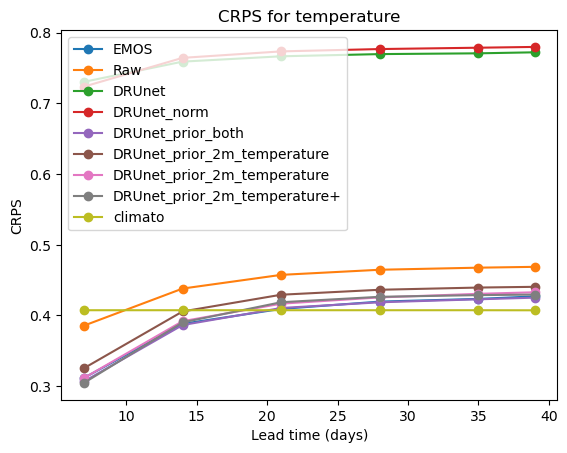

In [18]:
lead_times= [7,14,21,28,35,39]

emos_year_temp.plot(label='EMOS', marker='o')
raw_year_temp.plot(label='Raw', marker='o')
#clim_year_temp.plot(label='Climatology', marker='o')
lats = ds_lead.latitude
weights = np.cos(np.deg2rad(lats)) # only adapted to drunet format !
plt.title("CRPS for temperature")
#plt.plot(lead_times, (ds_lead["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp, marker='o')
#plt.plot(lead_times, (ds2* land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude', 'time')), label="try", marker='o')
plt.plot(lead_times, (ds_lead2["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp2, marker='o')
plt.plot(lead_times, (ds_lead3["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:], label=exp3, marker='o')
#plt.plot(lead_times, (ds_lead4["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:], label=f"{exp4}_w", marker='o')
plt.plot(lead_times, (ds_lead5["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp5, marker='o')
plt.plot(lead_times, (ds_lead6["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp6, marker='o')
#plt.plot(lead_times, (ds_lead7["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp7, marker='o')
plt.plot(lead_times, (ds_lead9["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp9, marker='o')
plt.plot(lead_times, (ds_lead11["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=f"{exp11}+", marker='o')
plt.plot(lead_times, (ds_lead["crps_temperature_climato"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label="climato", marker='o')
plt.xlabel("Lead time (days)")
plt.ylabel("CRPS")  
plt.legend()
plt.show()


In [37]:
emos_year_temp[:2].mean(), emos_year_temp[2:4].mean(), emos_year_temp[4:].mean()
emos_year_wind[:2].mean(), emos_year_wind[2:4].mean(), emos_year_wind[4:].mean()
#raw_year_temp[:2].mean(), raw_year_temp[2:4].mean(), raw_year_temp[4:].mean()
#raw_year_wind[:2].mean(), raw_year_wind[2:4].mean(), raw_year_wind[4:].mean()
(ds_lead["crps_wind_speed_climato"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))

<xarray.DataArray 'crps_wind_speed_climato' (lead_time: 6)>
array([0.14215083, 0.14215083, 0.14215083, 0.14215083, 0.14215083,
       0.14216073])
Coordinates:
  * lead_time  (lead_time) int64 1 2 3 4 5 6

In [16]:
# drunet 
exp3, (ds_lead3["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:][:2].mean(), (ds_lead3["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:][2:4].mean(), (ds_lead3["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:][4:].mean()
exp5, (ds_lead5["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[:2].mean(), (ds_lead5["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[2:4].mean(), (ds_lead5["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[4:].mean()
#exp6, (ds_lead6["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[:2].mean(), (ds_lead6["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[2:4].mean(), (ds_lead6["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[4:].mean()
#exp9, (ds_lead9["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[:2].mean(), (ds_lead9["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[2:4].mean(), (ds_lead9["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[4:].mean()

# wind

#exp3, (ds_lead3["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:][:2].mean(), (ds_lead3["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:][2:4].mean(), (ds_lead3["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:][4:].mean()
#exp5, (ds_lead5["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[:2].mean(), (ds_lead5["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[2:4].mean(), (ds_lead5["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[4:].mean()
exp8, (ds_lead8["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[:2].mean(), (ds_lead8["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[2:4].mean(), (ds_lead8["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[4:].mean()

NameError: name 'weights' is not defined

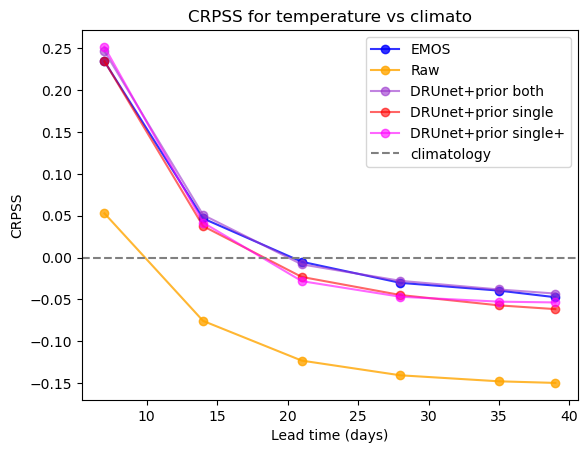

In [42]:
# plot CRPSS version 1: good 
(1- emos_year_temp/clim_year_temp).plot(label='EMOS', marker='o', color="blue", alpha=0.8)
(1- raw_year_temp/clim_year_temp).plot(label='Raw', marker='o', color="orange", alpha=0.8)

#plt.plot(lead_times, 1 - (ds_lead2["crps_temperature"]).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label=exp2, marker='o')
#plt.plot(lead_times, 1 - (ds_lead3["crps_temperature"]).weighted(weights).mean(dim=('latitude', 'longitude')).values[1:] / clim_year_temp.values, label=exp3, marker='o')
plt.plot(lead_times, 1 - (ds_lead5["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label="DRUnet+prior both", marker='o', color="darkorchid", alpha=0.6)
#plt.plot(lead_times, 1 - (ds_lead6["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label=exp6, marker='o')
plt.plot(lead_times, 1 - (ds_lead9["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label="DRUnet+prior single", marker='o', color="red", alpha=0.6)
plt.plot(lead_times, 1 - (ds_lead11["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label=f"DRUnet+prior single+", marker='o', color="fuchsia", alpha=0.6)
# draw grey line at 0 
plt.axhline(0, color='grey', linestyle='--', label='climatology')
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.title("CRPSS for temperature vs climato")
plt.legend()
plt.show()


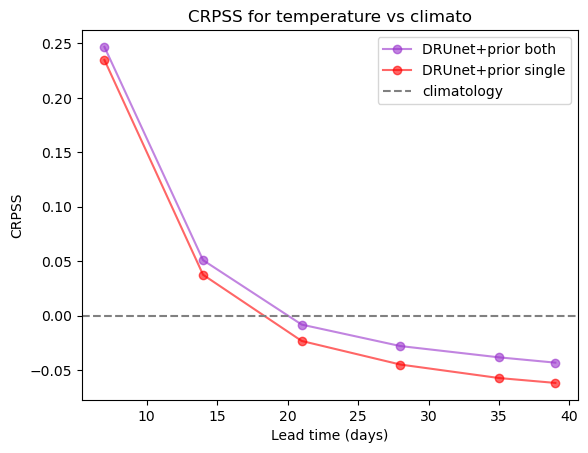

In [43]:
# plot CRPSS version 1: good 
#(1- emos_year_temp/clim_year_temp).plot(label='EMOS', marker='o', color="blue", alpha=0.8)
#(1- raw_year_temp/clim_year_temp).plot(label='Raw', marker='o', color="orange", alpha=0.8)

#plt.plot(lead_times, 1 - (ds_lead2["crps_temperature"]).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label=exp2, marker='o')
#plt.plot(lead_times, 1 - (ds_lead3["crps_temperature"]).weighted(weights).mean(dim=('latitude', 'longitude')).values[1:] / clim_year_temp.values, label=exp3, marker='o')
plt.plot(lead_times, 1 - (ds_lead5["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label="DRUnet+prior both", marker='o', color="darkorchid", alpha=0.6)
#plt.plot(lead_times, 1 - (ds_lead6["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label=exp6, marker='o')
plt.plot(lead_times, 1 - (ds_lead9["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label="DRUnet+prior single", marker='o', color="red", alpha=0.6)
#plt.plot(lead_times, 1 - (ds_lead11["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label=f"DRUnet+prior single+", marker='o', color="fuchsia", alpha=0.6)
# draw grey line at 0 
plt.axhline(0, color='grey', linestyle='--', label='climatology')
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.title("CRPSS for temperature vs climato")
plt.legend()
plt.show()


In [ ]:
# plot CRPSS version 1: good 
#(1- emos_year_temp/clim_year_temp).plot(label='EMOS', marker='o', color="blue", alpha=0.8)
#(1- raw_year_temp/clim_year_temp).plot(label='Raw', marker='o', color="orange", alpha=0.8)

#plt.plot(lead_times, 1 - (ds_lead2["crps_temperature"]).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label=exp2, marker='o')
#plt.plot(lead_times, 1 - (ds_lead3["crps_temperature"]).weighted(weights).mean(dim=('latitude', 'longitude')).values[1:] / clim_year_temp.values, label=exp3, marker='o')
plt.plot(lead_times, 1 - (ds_lead5["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label="DRUnet+prior both", marker='o', color="darkorchid", alpha=0.6)
#plt.plot(lead_times, 1 - (ds_lead6["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label=exp6, marker='o')
plt.plot(lead_times, 1 - (ds_lead9["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label="DRUnet+prior single", marker='o', color="red", alpha=0.6)
plt.plot(lead_times, 1 - (ds_lead11["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_temp.values, label=f"DRUnet+prior single+", marker='o', color="sienna", alpha=0.6)
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.title("CRPSS for temperature vs climato")
plt.legend()
plt.show()


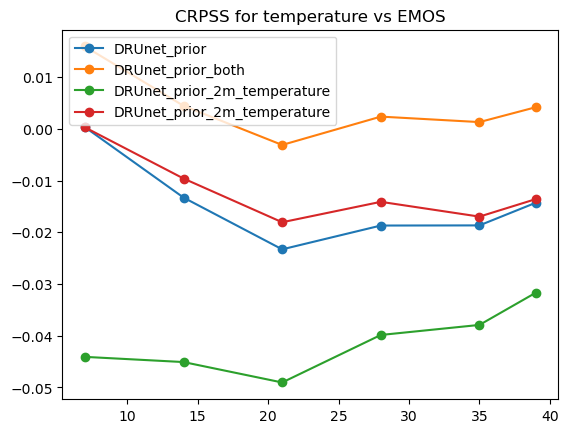

In [141]:
#plt.plot(lead_times, 1 - raw_year_temp/emos_year_temp, label='Raw', marker='o')
plt.plot(lead_times, 1 - (ds_lead["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / emos_year_temp.values, label=exp, marker='o')
plt.plot(lead_times, 1 - (ds_lead5["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / emos_year_temp.values, label=exp5, marker='o')
plt.plot(lead_times, 1 - (ds_lead6["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / emos_year_temp.values, label=exp6, marker='o')
plt.plot(lead_times, 1 - (ds_lead9["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / emos_year_temp.values, label=exp9, marker='o')
plt.title("CRPSS for temperature vs EMOS")
plt.legend()
plt.show()

In [27]:
# weights issue: use weights based on xarray format 
obs_folder = "/home/majanvie/scratch/data/raw/obs"
land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.values.T[lat_beg:,:]
land_sea_mask = land_sea_mask > 0.5
# remove problematic pixel
land_sea_mask[77-lat_beg,19] = 0

ds_mean = emos_temp_ds.mean(dim='forecast_idx')[:,lat_beg:, :]
lats = ds_mean.latitude
weights2 = np.cos(np.deg2rad(lats))
crps_year = (ds_mean*land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))
crps_year

weights == weights2 # true in values but not in broadcasting
1 - emos_year_temp/clim_year_temp == 1 - ((emos_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]* land_sea_mask).weighted(weights2).mean(dim=('latitude', 'longitude'))/ (clim_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]*land_sea_mask).weighted(weights2).mean(dim=('latitude', 'longitude')))

<xarray.DataArray (lead_time: 6)>
array([ True,  True,  True,  True,  True,  True])
Coordinates:
  * lead_time  (lead_time) int64 7 14 21 28 35 39

In [151]:
(1 - (emos_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]* land_sea_mask)/ (clim_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]*land_sea_mask)).weighted(weights2).mean(dim=('latitude', 'longitude'))

<xarray.DataArray (lead_time: 6)>
array([ 0.23586494,  0.0581899 ,  0.00812412, -0.01749053, -0.02637592,
       -0.0329258 ])
Coordinates:
  * lead_time  (lead_time) int64 7 14 21 28 35 39

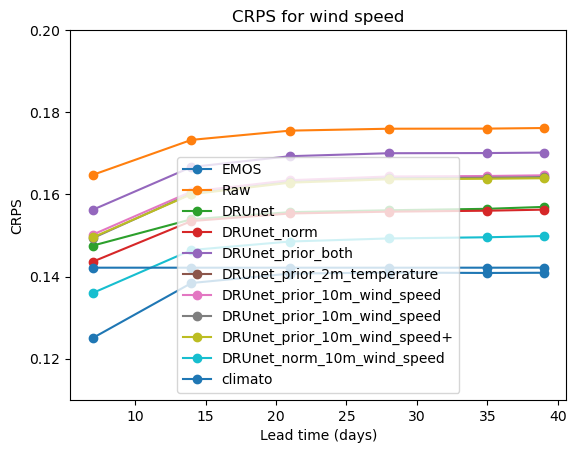

In [17]:
emos_year_wind.plot(label='EMOS', marker='o')
raw_year_wind.plot(label='Raw', marker='o')
plt.title("CRPS for wind speed")
#plt.plot(lead_times, (ds_lead["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp, marker='o')
plt.plot(lead_times, (ds_lead2["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp2, marker='o')
plt.plot(lead_times, (ds_lead3["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:], label=exp3, marker='o')
#plt.plot(lead_times, (ds_lead4["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:], label=f"{exp4}_w", marker='o')
plt.plot(lead_times, (ds_lead5["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp5, marker='o')
plt.plot(lead_times, (ds_lead6["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp6, marker='o')
plt.plot(lead_times, (ds_lead7["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp7, marker='o')
plt.plot(lead_times, (ds_lead8["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp8, marker='o')
plt.plot(lead_times, (ds_lead10["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=f"{exp10}+", marker='o')
plt.plot(lead_times, (ds_lead12["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:], label=exp12, marker='o')
plt.plot(lead_times, (ds_lead["crps_wind_speed_climato"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label="climato", marker='o')
plt.xlabel("Lead time (days)")
plt.ylabel("CRPS") 
plt.ylim(0.11, 0.2) 
plt.legend()
plt.show()

In [21]:
(1 - ds_lead12["crps_wind_speed"]/ds_lead12["crps_wind_speed_climato"]).mean(dim=('latitude', 'longitude'))

<xarray.DataArray (lead_time: 7)>
array([ 0.41661885,  0.10089143,  0.00553761, -0.01370546, -0.02007286,
       -0.02279956, -0.02451319], dtype=float32)
Coordinates:
  * lead_time  (lead_time) int64 0 1 2 3 4 5 6

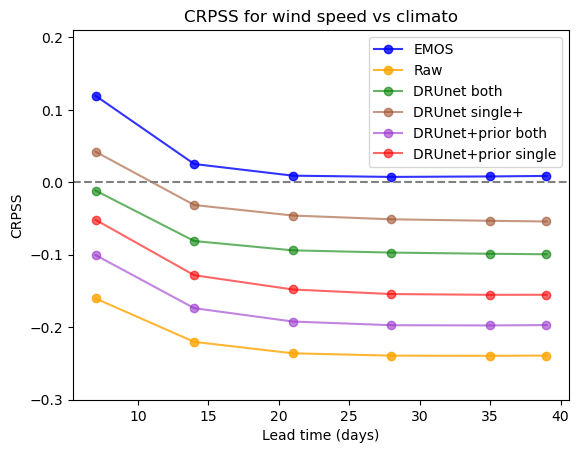

In [36]:
# plot CRPSS wind
(1- emos_year_wind/clim_year_wind).plot(label='EMOS', marker='o', color="blue", alpha=0.8)
(1- raw_year_wind/clim_year_wind).plot(label='Raw', marker='o', color="orange", alpha=0.8)
#plt.plot(lead_times, 1 - (ds_lead2["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_wind.values, label=exp2, marker='o')
plt.plot(lead_times, 1 - (ds_lead3["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values[1:] / clim_year_wind.values, label="DRUnet both", marker='o', color="green", alpha=0.6)
plt.plot(lead_times, 1 - (ds_lead12["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values[1:] / clim_year_wind.values, label=f"DRUnet single+", color="sienna", marker='o', alpha=0.6)
plt.plot(lead_times, 1 - (ds_lead5["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_wind.values, label="DRUnet+prior both", marker='o', color="darkorchid", alpha=0.6)
#plt.plot(lead_times, 1 - (ds_lead6["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_wind.values, label=exp6, marker='o')
#plt.plot(lead_times, 1 - (ds_lead7["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_wind.values, label=exp7, marker='o')
plt.plot(lead_times, 1 - (ds_lead8["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_wind.values, label="DRUnet+prior single", marker='o', color="red", alpha=0.6)
plt.axhline(0, color='grey', linestyle='--')
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.title("CRPSS for wind speed vs climato")
plt.ylim(-0.3,0.21)
plt.legend()
plt.show()


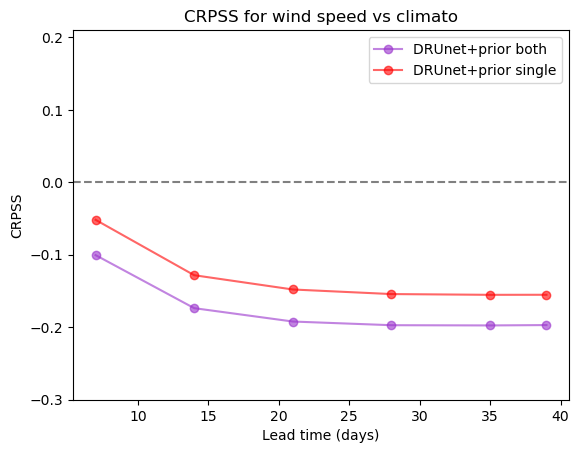

In [45]:
# plot CRPSS wind
#(1- emos_year_wind/clim_year_wind).plot(label='EMOS', marker='o', color="blue", alpha=0.8)
#(1- raw_year_wind/clim_year_wind).plot(label='Raw', marker='o', color="orange", alpha=0.8)
#plt.plot(lead_times, 1 - (ds_lead2["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_wind.values, label=exp2, marker='o')
#plt.plot(lead_times, 1 - (ds_lead3["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values[1:] / clim_year_wind.values, label="DRUnet both", marker='o', color="green", alpha=0.6)
#plt.plot(lead_times, 1 - (ds_lead12["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values[1:] / clim_year_wind.values, label=f"DRUnet single+", color="sienna", marker='o', alpha=0.6)
plt.plot(lead_times, 1 - (ds_lead5["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_wind.values, label="DRUnet+prior both", marker='o', color="darkorchid", alpha=0.6)
#plt.plot(lead_times, 1 - (ds_lead6["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_wind.values, label=exp6, marker='o')
#plt.plot(lead_times, 1 - (ds_lead7["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_wind.values, label=exp7, marker='o')
plt.plot(lead_times, 1 - (ds_lead8["crps_wind_speed"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')).values / clim_year_wind.values, label="DRUnet+prior single", marker='o', color="red", alpha=0.6)
plt.axhline(0, color='grey', linestyle='--')
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.title("CRPSS for wind speed vs climato")
plt.ylim(-0.3,0.21)
plt.legend()
plt.show()


In [87]:
1- emos_year_wind/clim_year_wind

<xarray.DataArray (lead_time: 6)>
array([0.11944813, 0.0252752 , 0.00917718, 0.00744303, 0.0081111 ,
       0.00879466])
Coordinates:
  * lead_time  (lead_time) int64 7 14 21 28 35 39

### latitude

In [28]:
def weight_latitude_zone(lat_beg_idx, ds_crps, type, cutoff_mask=0.5):
    # mask 
    obs_folder = "/home/majanvie/scratch/data/raw/obs"
    land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.values.T[lat_beg_idx:,:]
    land_sea_mask = land_sea_mask > cutoff_mask
    # remove problematic pixel
    land_sea_mask[77-lat_beg_idx,19] = 0

    # compute yearly crps per lead time
    if type == "crps":
        ds_mean = ds_crps.mean(dim='forecast_idx')[:,lat_beg_idx:, :]
    elif type == "crpss":
        ds_mean = ds_crps #[:,lat_beg_idx:, :]
    # weights per latitude 
    lats = ds_mean.latitude
    weights = np.cos(np.deg2rad(lats))
    crps_year = (ds_mean*land_sea_mask)
    crps_lat = {
        "land": crps_year.weighted(weights).mean(dim=('latitude', 'longitude')),
        "90-30N": crps_year.sel(latitude=slice(30, 90)).weighted(weights.sel(latitude=slice(30, 90))).mean(dim=('latitude', 'longitude')),
        "30S-30N": crps_year.sel(latitude=slice(-30, 30)).weighted(weights.sel(latitude=slice(-30, 30))).mean(dim=('latitude', 'longitude')),
        "30-90S": crps_year.sel(latitude=slice(-90, -30)).weighted(weights.sel(latitude=slice(-90, -30))).mean(dim=('latitude', 'longitude'))
            }
    return crps_lat

crps_emos_lat = weight_latitude_zone(lat_beg, emos_temp_ds, type="crps")
crps_raw_lat = weight_latitude_zone(lat_beg, raw_temp_ds, type="crps")
crps_clim_lat = weight_latitude_zone(lat_beg, clim_temp_ds, type="crps")
# wind 
crps_emos_lat_wind = weight_latitude_zone(lat_beg, emos_wind_ds, type="crps")
crps_raw_lat_wind = weight_latitude_zone(lat_beg, raw_wind_ds, type="crps")
crps_clim_lat_wind = weight_latitude_zone(lat_beg, clim_wind_ds, type="crps")

In [18]:
for key in crps_emos_lat.keys():
    #print(key, crps_emos_lat[key].values[:2].mean(), crps_emos_lat[key].values[2:4].mean(), crps_emos_lat[key].values[4:].mean())
    #print(key, crps_raw_lat[key].values[:2].mean(), crps_raw_lat[key].values[2:4].mean(), crps_raw_lat[key].values[4:].mean())
    #print(key, crps_clim_lat[key].values[:2].mean(), crps_clim_lat[key].values[2:4].mean(), crps_clim_lat[key].values[4:].mean())
    print(key, crps_emos_lat_wind[key].values[:2].mean(), crps_emos_lat_wind[key].values[2:4].mean(), crps_emos_lat_wind[key].values[4:].mean())
    #print(key, crps_raw_lat_wind[key].values[:2].mean(), crps_raw_lat_wind[key].values[2:4].mean(), crps_raw_lat_wind[key].values[4:].mean())
    #print(key, crps_clim_lat_wind[key].values[:2].mean(), crps_clim_lat_wind[key].values[2:4].mean(), crps_clim_lat_wind[key].values[4:].mean())

land 0.13172829801213964 0.1408396371166985 0.14089335294599475
90-30N 0.23811565894458164 0.25030631607673653 0.250011085681361
30S-30N 0.08659571100957898 0.0957920931002904 0.09625622853157409
30-90S 0.115934995828329 0.12177397320670244 0.12137640536650154


In [29]:
# for drunet 
def build_crps_lat(ds_arr, variable, mask, weights): # weight here because different format
    crps_year = ds_arr[f"crps_{variable}"] * mask 
    crps_lat = {
        "land": crps_year.weighted(weights).mean(dim=('latitude', 'longitude')),
        "90-30N": crps_year.sel(latitude=slice(30, 90)).weighted(weights.sel(latitude=slice(30, 90))).mean(dim=('latitude', 'longitude')),
        "30S-30N": crps_year.sel(latitude=slice(-30, 30)).weighted(weights.sel(latitude=slice(-30, 30))).mean(dim=('latitude', 'longitude')),
        "30-90S": crps_year.sel(latitude=slice(-90, -30)).weighted(weights.sel(latitude=slice(-90, -30))).mean(dim=('latitude', 'longitude'))
            }
    return crps_lat

# for ds 3,5,8,9
crps_drunet3_lat_temp = build_crps_lat(ds_lead3, "temperature", land_sea_mask, weights)
crps_drunet5_lat_temp = build_crps_lat(ds_lead5, "temperature", land_sea_mask, weights)
crps_drunet3_lat_wind = build_crps_lat(ds_lead3, "wind_speed", land_sea_mask, weights)
crps_drunet5_lat_wind = build_crps_lat(ds_lead5, "wind_speed", land_sea_mask, weights)
crps_drunet8_lat_wind = build_crps_lat(ds_lead8, "wind_speed", land_sea_mask, weights)
crps_drunet9_lat_temp = build_crps_lat(ds_lead9, "temperature", land_sea_mask, weights)


In [70]:
for key in crps_drunet3_lat_temp.keys():
    #print(key, exp3, crps_drunet3_lat_temp[key].values[1:3].mean(), crps_drunet3_lat_temp[key].values[3:5].mean(), crps_drunet3_lat_temp[key].values[5:].mean())
    #print(key, exp5, crps_drunet5_lat_temp[key].values[:2].mean(), crps_drunet5_lat_temp[key].values[2:4].mean(), crps_drunet5_lat_temp[key].values[4:].mean())
    #print(key, exp3, crps_drunet3_lat_wind[key].values[1:3].mean(), crps_drunet3_lat_wind[key].values[3:5].mean(), crps_drunet3_lat_wind[key].values[5:].mean())
    #print(key, exp5, crps_drunet5_lat_wind[key].values[:2].mean(), crps_drunet5_lat_wind[key].values[2:4].mean(), crps_drunet5_lat_wind[key].values[4:].mean())
    #print(key, exp8, crps_drunet8_lat_wind[key].values[:2].mean(), crps_drunet8_lat_wind[key].values[2:4].mean(), crps_drunet8_lat_wind[key].values[4:].mean())
     print(key, crps_drunet9_lat_temp[key].values[:2].mean(), crps_drunet9_lat_temp[key].values[2:4].mean(), crps_drunet9_lat_temp[key].values[4:].mean())

land 0.3517322331193222 0.4211413679140352 0.4317294244703611
90-30N 0.8081309337407254 0.9737248857444755 1.0038623060781884
30S-30N 0.18115166123290977 0.22017640505018513 0.22562297748008628
30-90S 0.2491684721214814 0.2860793053014027 0.28803984297178953


## CRPSS lead: meme chose en plus compliqué

In [46]:
# climato reformat to be compatible for Unet xarrays 
clim_temp_ds_unet = clim_temp_ds.mean(dim='forecast_idx').assign_coords(lead_time=[1,2,3,4,5,6])
# drop first latitude
clim_temp_ds_unet = clim_temp_ds_unet.isel(latitude=slice(1,None))
clim_temp_ds_unet = clim_temp_ds_unet.interp(latitude=ds['latitude'], longitude=ds['longitude'])
clim_temp_ds_unet

clim_wind_ds_unet = clim_wind_ds.mean(dim='forecast_idx').assign_coords(lead_time=[1,2,3,4,5,6])
# drop first latitude
clim_wind_ds_unet = clim_wind_ds_unet.isel(latitude=slice(1,None))
clim_wind_ds_unet = clim_wind_ds_unet.interp(latitude=ds['latitude'], longitude=ds['longitude'])
clim_wind_ds_unet

<xarray.DataArray (lead_time: 6, latitude: 120, longitude: 240)>
array([[[0.65413845, 0.65612704, 0.65788978, ..., 0.65006804,
         0.65054476, 0.65191764],
        [0.72083479, 0.72238892, 0.72464126, ..., 0.71731442,
         0.71815771, 0.71911508],
        [0.72396004, 0.72343177, 0.72325289, ..., 0.72775596,
         0.7263853 , 0.72430402],
        ...,
        [1.09989023, 1.09828043, 1.09751129, ..., 1.10483742,
         1.10210311, 1.10043252],
        [1.04611659, 1.04519701, 1.04446661, ..., 1.04521513,
         1.04466438, 1.04512477],
        [0.99614251, 0.99503696, 0.99371994, ..., 0.98983556,
         0.99175721, 0.99400216]],

       [[0.65398639, 0.65597123, 0.6577304 , ..., 0.64992291,
         0.6503967 , 0.65176755],
        [0.72071719, 0.72226322, 0.7245056 , ..., 0.71720064,
         0.71804309, 0.71899933],
        [0.7239219 , 0.72340083, 0.72322673, ..., 0.72768545,
         0.726327  , 0.72425592],
...
        [1.09620023, 1.09457362, 1.09379172, ..., 1.10123742,
         1.09846568, 1.096766  ],
        [1.04261017, 1.04167747, 1.04093575, ..., 1.04173386,
         1.04117298, 1.0416249 ],
        [0.99340117, 0.99229026, 0.99096853, ..., 0.98712975,
         0.98903942, 0.99127221]],

       [[0.65404767, 0.65594441, 0.65760535, ..., 0.65025425,
         0.65064579, 0.65192008],
        [0.72163075, 0.72327417, 0.7256065 , ..., 0.71847236,
         0.71916044, 0.71998513],
        [0.73023635, 0.73001069, 0.73014796, ..., 0.73320431,
         0.73203629, 0.73026603],
        ...,
        [1.10884643, 1.1084137 , 1.1090014 , ..., 1.11259389,
         1.11003745, 1.10873473],
        [1.07184136, 1.07071781, 1.06963074, ..., 1.07069206,
         1.0703094 , 1.07086706],
        [1.01570427, 1.01474941, 1.01357079, ..., 1.00873923,
         1.01089668, 1.01336038]]])
Coordinates:
  * lead_time  (lead_time) int64 1 2 3 4 5 6
  * latitude   (latitude) float64 -88.5 -87.0 -85.5 -84.0 ... 87.0 88.5 90.0
  * longitude  (longitude) float64 0.0 1.5 3.0 4.5 ... 354.0 355.5 357.0 358.5

In [20]:
# # DRUnet prior
# crpss_temp_ds = 1 - ds["crps_temperature"].groupby('lead_time').mean(dim='time')    / ds["crps_temperature_climato"].groupby('lead_time').mean(dim='time')   
# crpss_wind_ds = 1 - ds["crps_wind_speed"].groupby('lead_time').mean(dim='time')    / ds["crps_wind_speed_climato"].groupby('lead_time').mean(dim='time')
# crpss_temp_ds
# # DRUnet
# crpss_temp_ds2 = 1 - ds2["crps_temperature"].groupby('lead_time').mean(dim='time')    / ds2["crps_temperature_climato"].groupby('lead_time').mean(dim='time')   
# crpss_wind_ds2 = 1 - ds2["crps_wind_speed"].groupby('lead_time').mean(dim='time')    / ds2["crps_wind_speed_climato"].groupby('lead_time').mean(dim='time')
# crpss_temp_ds2
# # DRUnet norm
# crpss_temp_ds3 = 1 - ds3["crps_temperature"].groupby('lead_time').mean(dim='time')    / ds3["crps_temperature_climato"].groupby('lead_time').mean(dim='time')
# crpss_wind_ds3 = 1 - ds3["crps_wind_speed"].groupby('lead_time').mean(dim='time')    / ds3["crps_wind_speed_climato"].groupby('lead_time').mean(dim='time')
# crpss_temp_ds3

# # DRUnet norm avec weight loss init
# crpss_temp_ds4 = 1 - ds4["crps_temperature"].groupby('lead_time').mean(dim='time')    / ds4["crps_temperature_climato"].groupby('lead_time').mean(dim='time')
# crpss_wind_ds4 = 1 - ds4["crps_wind_speed"].groupby('lead_time').mean(dim='time')    / ds4["crps_wind_speed_climato"].groupby('lead_time').mean(dim='time')
# crpss_temp_ds4

# # DRUnet prior both 
# crpss_temp_ds5 = 1 - ds5["crps_temperature"].groupby('lead_time').mean(dim='time')    / ds5["crps_temperature_climato"].groupby('lead_time').mean(dim='time')
# crpss_wind_ds5 = 1 - ds5["crps_wind_speed"].groupby('lead_time').mean(dim='time')    / ds5["crps_wind_speed_climato"].groupby('lead_time').mean(dim='time')
# crpss_temp_ds5

# # drunet prior temp only
# crpss_temp_ds6 = 1 - ds6["crps_temperature"].groupby('lead_time').mean(dim='time')    / ds6["crps_temperature_climato"].groupby('lead_time').mean(dim='time')
# crpss_wind_ds6 = 1 - ds6["crps_wind_speed"].groupby('lead_time').mean(dim='time')    / ds6["crps_wind_speed_climato"].groupby('lead_time').mean(dim='time')
# crpss_temp_ds6

# # drunet prior wind only
# crpss_temp_ds7 = 1 - ds7["crps_temperature"].groupby('lead_time').mean(dim='time')    / ds7["crps_temperature_climato"].groupby('lead_time').mean(dim='time')
# crpss_wind_ds7 = 1 - ds7["crps_wind_speed"].groupby('lead_time').mean(dim='time')    / ds7["crps_wind_speed_climato"].groupby('lead_time').mean(dim='time')
# crpss_temp_ds7

# # drunet prior wind only, single unet
# #crpss_wind_ds8 = 1 - ds8["crps_wind_speed"].groupby('lead_time').mean(dim='time')    / ds8["crps_wind_speed_climato"].groupby('lead_time').mean(dim='time')

# # drunet prior temp only, single unet
# crpss_temp_ds9 = 1 - ds9["crps_temperature"].groupby('lead_time').mean(dim='time')    / ds9["crps_temperature_climato"].groupby('lead_time').mean(dim='time')

In [47]:
def build_crpss_map_time_avg(ds_arr, ds_arr_clim, variable, mask, W1, W2): # weight here because different format
    return 1 - (ds_arr[f"crps_{variable}"].groupby('lead_time').mean(dim='time') * mask).weighted(W1).mean(dim=('latitude', 'longitude')) / (ds_arr_clim * mask).weighted(W2).mean(dim=('latitude', 'longitude'))

In [48]:
# DRUnet prior
crpss_temp_ds = build_crpss_map_time_avg(ds, clim_temp_ds_unet, "temperature", land_sea_mask, weights, weights)
crpss_wind_ds = build_crpss_map_time_avg(ds, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, weights)
crpss_temp_ds
# DRUnet
crpss_temp_ds2 = build_crpss_map_time_avg(ds2, clim_temp_ds_unet, "temperature", land_sea_mask, weights, weights)
crpss_wind_ds2 = build_crpss_map_time_avg(ds2, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, weights)
crpss_temp_ds2
# DRUnet norm
crpss_temp_ds3 = build_crpss_map_time_avg(ds3, clim_temp_ds_unet, "temperature", land_sea_mask, weights, weights)
crpss_wind_ds3 = build_crpss_map_time_avg(ds3, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, weights)
crpss_temp_ds3

# DRUnet norm avec weight loss init
crpss_temp_ds4 = build_crpss_map_time_avg(ds4, clim_temp_ds_unet, "temperature", land_sea_mask, weights, weights)
crpss_wind_ds4 = build_crpss_map_time_avg(ds4, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, weights)
crpss_temp_ds4

# DRUnet prior both 
crpss_temp_ds5 = build_crpss_map_time_avg(ds5, clim_temp_ds_unet, "temperature", land_sea_mask, weights, weights)
crpss_wind_ds5 = build_crpss_map_time_avg(ds5, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, weights)
crpss_temp_ds5

# drunet prior temp only
crpss_temp_ds6 = build_crpss_map_time_avg(ds6, clim_temp_ds_unet, "temperature", land_sea_mask, weights, weights)
crpss_wind_ds6 = build_crpss_map_time_avg(ds6, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, weights)
crpss_temp_ds6

# drunet prior wind only
crpss_temp_ds7 = build_crpss_map_time_avg(ds7, clim_temp_ds_unet, "temperature", land_sea_mask, weights, weights)
crpss_wind_ds7 = build_crpss_map_time_avg(ds7, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, weights)
crpss_temp_ds7

# drunet prior wind only, single unet
crpss_wind_ds8 = build_crpss_map_time_avg(ds8, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, weights)

# drunet prior temp only, single unet
crpss_temp_ds9 = build_crpss_map_time_avg(ds9, clim_temp_ds_unet, "temperature", land_sea_mask, weights, weights)




In [49]:
# drunet single wind
crpss_wind_ds12 = build_crpss_map_time_avg(ds12, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, weights)

In [50]:
# EMOS, RAW
emos_temp_crpss_ds = 1 - (emos_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:] * land_sea_mask) / (clim_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]* land_sea_mask)
raw_temp_crpss_ds = 1 - (raw_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:] * land_sea_mask) / (clim_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:] * land_sea_mask)
emos_wind_crpss_ds = 1 - (emos_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:] * land_sea_mask) / (clim_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:] * land_sea_mask)
raw_wind_crpss_ds = 1 - (raw_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:] * land_sea_mask) / (clim_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:] * land_sea_mask) 
emos_temp_crpss_ds

<xarray.DataArray (lead_time: 6, latitude: 120, longitude: 240)>
array([[[ 1.8092042e-01,  1.7742944e-01,  1.7980570e-01, ...,
          1.7839098e-01,  1.8085772e-01,  1.7849118e-01],
        [ 1.6879064e-01,  1.7203081e-01,  1.7216742e-01, ...,
          1.6732800e-01,  1.6792572e-01,  1.6909945e-01],
        [ 1.7049140e-01,  1.6999787e-01,  1.7524469e-01, ...,
          1.6804069e-01,  1.6661215e-01,  1.6888535e-01],
        ...,
        [           nan,            nan,            nan, ...,
                    nan,            nan,            nan],
        [           nan,            nan,            nan, ...,
                    nan,            nan,            nan],
        [           nan,            nan,            nan, ...,
                    nan,            nan,            nan]],

       [[-1.3756752e-03, -3.0434132e-04,  3.3974648e-05, ...,
         -1.3921261e-03, -1.7420053e-03, -8.0764294e-04],
        [-1.1587143e-04,  8.0311298e-04,  3.1400323e-03, ...,
          1.6641617e-03,  8.4286928e-04,  2.7579665e-03],
        [ 1.6808450e-02,  1.5567064e-02,  1.4926732e-02, ...,
          1.7566204e-02,  1.7858863e-02,  1.8611670e-02],
...
        [           nan,            nan,            nan, ...,
                    nan,            nan,            nan],
        [           nan,            nan,            nan, ...,
                    nan,            nan,            nan],
        [           nan,            nan,            nan, ...,
                    nan,            nan,            nan]],

       [[-1.5959024e-02, -2.5753260e-02, -1.5402436e-02, ...,
         -2.0226002e-02, -1.5382886e-02, -1.8912315e-02],
        [-1.9976139e-02, -1.6369224e-02, -1.4313817e-02, ...,
         -1.5119314e-02, -1.6281605e-02, -2.0583153e-02],
        [-1.2140274e-03,  1.1181831e-04, -9.7799301e-04, ...,
         -1.9217730e-03, -2.3779869e-03, -3.1938553e-03],
        ...,
        [           nan,            nan,            nan, ...,
                    nan,            nan,            nan],
        [           nan,            nan,            nan, ...,
                    nan,            nan,            nan],
        [           nan,            nan,            nan, ...,
                    nan,            nan,            nan]]], dtype=float32)
Coordinates:
  * lead_time  (lead_time) int64 7 14 21 28 35 39
  * latitude   (latitude) float64 -88.5 -87.0 -85.5 -84.0 ... 87.0 88.5 90.0
  * longitude  (longitude) float64 0.0 1.5 3.0 4.5 ... 354.0 355.5 357.0 358.5

In [18]:
# crpss_temp_emos = weight_latitude(lat_beg, emos_temp_crpss_ds, type="crpss")
# crpss_wind_emos = weight_latitude(lat_beg, emos_wind_crpss_ds, type="crpss")
# crpss_temp_raw = weight_latitude(lat_beg, raw_temp_crpss_ds, type="crpss") 
# crpss_wind_raw = weight_latitude(lat_beg, raw_wind_crpss_ds, type="crpss")
# crpss_temp_emos

<xarray.DataArray (lead_time: 6)>
array([ 0.06781489,  0.01673051,  0.00233581, -0.0050288 , -0.00758349,
       -0.00946669])
Coordinates:
  * lead_time  (lead_time) int64 7 14 21 28 35 39

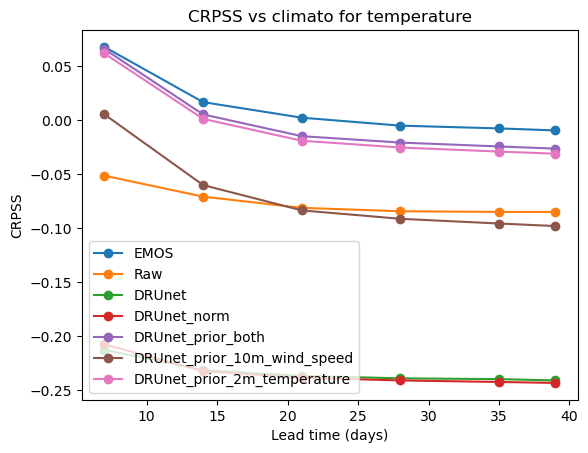

In [21]:
# old versions
# plt.title("CRPSS vs climato for temperature")
# plt.plot(lead_times, crpss_temp_emos, label="EMOS", marker='o')
# plt.plot(lead_times, crpss_temp_raw, label="Raw", marker='o')
# #plt.plot(lead_times, (crpss_temp_ds * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp, marker='o')
# plt.plot(lead_times, (crpss_temp_ds2 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp2, marker='o')
# plt.plot(lead_times, (crpss_temp_ds3 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:], label=exp3, marker='o')
# #plt.plot(lead_times, (crpss_temp_ds4 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:], label=f"{exp4}_w", marker='o')
# plt.plot(lead_times, (crpss_temp_ds5 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp5, marker='o')
# #plt.plot(lead_times, (crpss_temp_ds6 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp6, marker='o')
# plt.plot(lead_times, (crpss_temp_ds7 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp7, marker='o')
# plt.plot(lead_times, (crpss_temp_ds9 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp9, marker='o')
# plt.xlabel("Lead time (days)")
# plt.ylabel("CRPSS")
# # put legend under the plot 


# plt.legend()
# plt.show()


In [177]:
(clim_temp_ds_unet * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))

<xarray.DataArray (lead_time: 6)>
array([0.40713994, 0.40720519, 0.40725036, 0.40730855, 0.40732378,
       0.40765798])
Coordinates:
  * lead_time  (lead_time) int64 1 2 3 4 5 6

In [174]:
(clim_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]* land_sea_mask).weighted(weights2).mean(dim=('latitude', 'longitude'))

<xarray.DataArray (lead_time: 6)>
array([0.40713994, 0.40720519, 0.40725036, 0.40730855, 0.40732378,
       0.40765798])
Coordinates:
  * lead_time  (lead_time) int64 7 14 21 28 35 39

In [164]:
(ds2[f"crps_temperature"].groupby('lead_time').mean(dim='time') * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')) #/ (ds_arr_clim * mask).weighted(W2).mean(dim=('latitude', 'longitude'))

<xarray.DataArray 'crps_temperature' (lead_time: 6)>
array([0.73053273, 0.75910997, 0.76665724, 0.76976362, 0.77086276,
       0.7723021 ])
Coordinates:
  * lead_time  (lead_time) int64 1 2 3 4 5 6

In [162]:
(ds_lead2["crps_temperature"] * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))

<xarray.DataArray 'crps_temperature' (lead_time: 6)>
array([0.73053273, 0.75910997, 0.76665724, 0.76976362, 0.77086276,
       0.7723021 ])
Coordinates:
  * lead_time  (lead_time) int64 1 2 3 4 5 6

NameError: name 'weights2' is not defined

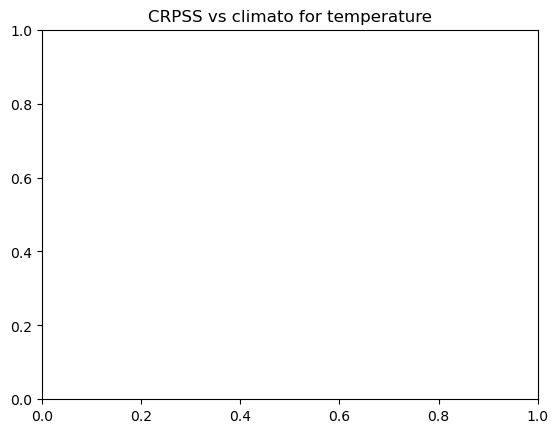

In [51]:
plt.title("CRPSS vs climato for temperature")
plt.plot(lead_times, emos_temp_crpss_ds.weighted(weights2).mean(dim=('latitude', 'longitude')), label="EMOS", marker='o')
plt.plot(lead_times, raw_temp_crpss_ds.weighted(weights2).mean(dim=('latitude', 'longitude')), label="Raw", marker='o')
#plt.plot(lead_times, (crpss_temp_ds * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp, marker='o')
#plt.plot(lead_times, (crpss_temp_ds2).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp2, marker='o')
#plt.plot(lead_times, (crpss_temp_ds3).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp3, marker='o')
#plt.plot(lead_times, (crpss_temp_ds4 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:], label=f"{exp4}_w", marker='o')
plt.plot(lead_times, (crpss_temp_ds5), label=exp5, marker='o')
#plt.plot(lead_times, (crpss_temp_ds6 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp6, marker='o')
plt.plot(lead_times, (crpss_temp_ds7), label=exp7, marker='o')
plt.plot(lead_times, (crpss_temp_ds9), label=exp9, marker='o')
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
# put legend under the plot 


plt.legend()
plt.show()


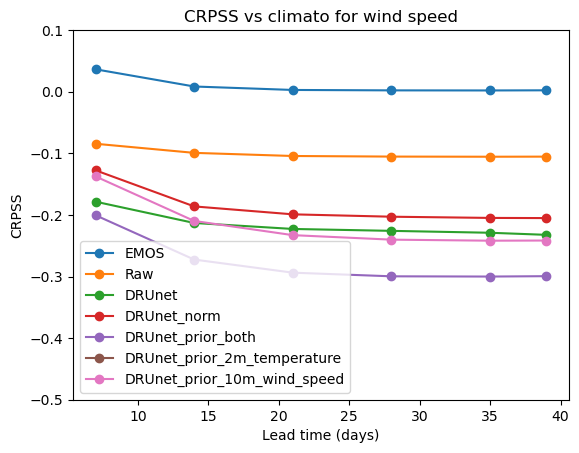

In [98]:
# old version
# plt.title("CRPSS vs climato for wind speed")
# plt.plot(lead_times, crpss_wind_emos, label="EMOS", marker='o')
# plt.plot(lead_times, crpss_wind_raw, label="Raw", marker='o')
# #plt.plot(lead_times, (crpss_wind_ds * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp, marker='o')
# plt.plot(lead_times, (crpss_wind_ds2 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp2, marker='o')
# plt.plot(lead_times, (crpss_wind_ds3 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp3, marker='o')
# #plt.plot(lead_times, (crpss_wind_ds4 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:], label=f"{exp4}_w", marker='o')
# plt.plot(lead_times, (crpss_wind_ds5 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp5, marker='o')
# plt.plot(lead_times, (crpss_wind_ds6 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp6, marker='o')
# plt.plot(lead_times, (crpss_wind_ds7 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp7, marker='o')
# plt.xlabel("Lead time (days)")
# plt.ylabel("CRPSS")
# plt.ylim(-0.5,0.1)
# plt.legend()
# plt.show()


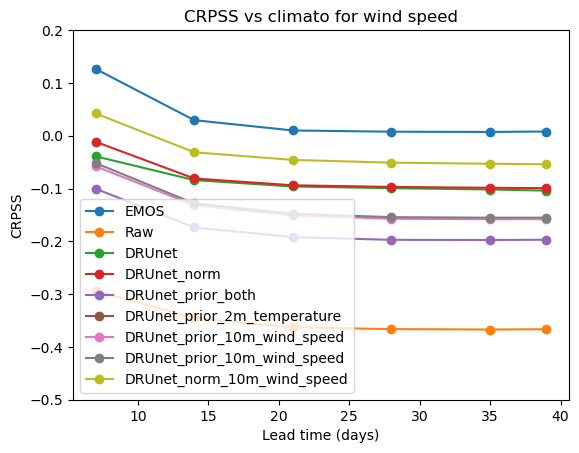

In [35]:
plt.plot(lead_times, emos_wind_crpss_ds.weighted(weights2).mean(dim=('latitude', 'longitude')), label="EMOS", marker='o')
plt.plot(lead_times, raw_wind_crpss_ds.weighted(weights2).mean(dim=('latitude', 'longitude')), label="Raw", marker='o')
#plt.plot(lead_times, (crpss_wind_ds * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label=exp, marker='o')
plt.plot(lead_times, (crpss_wind_ds2), label=exp2, marker='o')
plt.plot(lead_times, (crpss_wind_ds3), label=exp3, marker='o')
#plt.plot(lead_times, (crpss_wind_ds4 * land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude'))[1:], label=f"{exp4}_w", marker='o')
plt.plot(lead_times, (crpss_wind_ds5), label=exp5, marker='o')
plt.plot(lead_times, (crpss_wind_ds6 ), label=exp6, marker='o')
plt.plot(lead_times, (crpss_wind_ds7), label=exp7, marker='o')
plt.plot(lead_times, (crpss_wind_ds8), label=exp8, marker='o')
plt.plot(lead_times, (crpss_wind_ds12), label=exp12, marker='o')
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.ylim(-0.5,0.2)
plt.legend()
plt.title("CRPSS vs climato for wind speed")
plt.show()

## CRPSS latitude ponderation (old)

### EMOS

In [22]:
# by latitude zone
def weight_latitude_zone(lat_beg_idx, ds_crps, type, cutoff_mask=0.5):
    # mask 
    obs_folder = "/home/majanvie/scratch/data/raw/obs"
    land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.values.T[lat_beg_idx:,:]
    land_sea_mask = land_sea_mask > cutoff_mask
    # remove problematic pixel
    land_sea_mask[77-lat_beg_idx,19] = 0

    # compute yearly crps per lead time
    if type == "crps":
        ds_mean = ds_crps.mean(dim='forecast_idx')[:,lat_beg_idx:, :]
    elif type == "crpss":
        ds_mean = ds_crps #[:,lat_beg_idx:, :]
    # weights per latitude 
    lats = ds_mean.latitude
    weights = np.cos(np.deg2rad(lats))
    crps_year = ds_mean#(ds_mean*land_sea_mask)
    crps_lat = {
        "land": crps_year.weighted(weights).mean(dim=('latitude', 'longitude')),
        "90-30N": crps_year.sel(latitude=slice(30, 90)).weighted(weights.sel(latitude=slice(30, 90))).mean(dim=('latitude', 'longitude')),
        "30S-30N": crps_year.sel(latitude=slice(-30, 30)).weighted(weights.sel(latitude=slice(-30, 30))).mean(dim=('latitude', 'longitude')),
        "30-90S": crps_year.sel(latitude=slice(-90, -30)).weighted(weights.sel(latitude=slice(-90, -30))).mean(dim=('latitude', 'longitude'))
            }
    return crps_lat



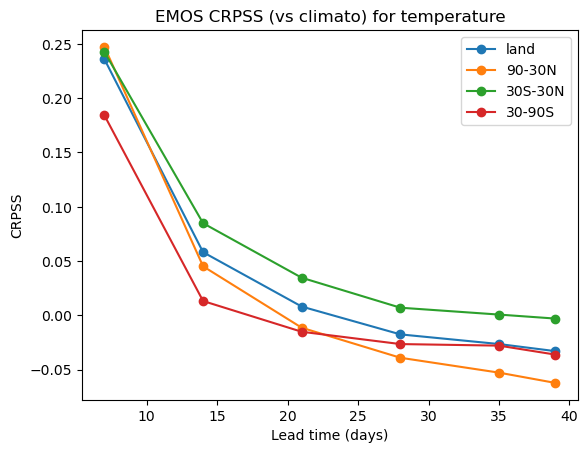

In [30]:
crpss_lat_emos = weight_latitude_zone(1, emos_temp_crpss_ds, type="crpss")
for key in crpss_lat_emos:
    plt.plot(lead_times, crpss_lat_emos[key], label=key, marker='o')
plt.title("EMOS CRPSS (vs climato) for temperature")
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.legend()
plt.show()

In [32]:
for key in crpss_lat_emos.keys():
    print(key, crpss_lat_emos[key].values[:2].mean(), crpss_lat_emos[key].values[2:4].mean(), crpss_lat_emos[key].values[4:].mean())

land 0.1470274221496612 -0.004683202568895695 -0.029650862152547308
90-30N 0.14620353928554072 -0.025188916079838808 -0.0574504470552894
30S-30N 0.1637491803405603 0.020874722874625717 -0.0010932425543915868
30-90S 0.09868863071093781 -0.02074061739390716 -0.03197693996334949


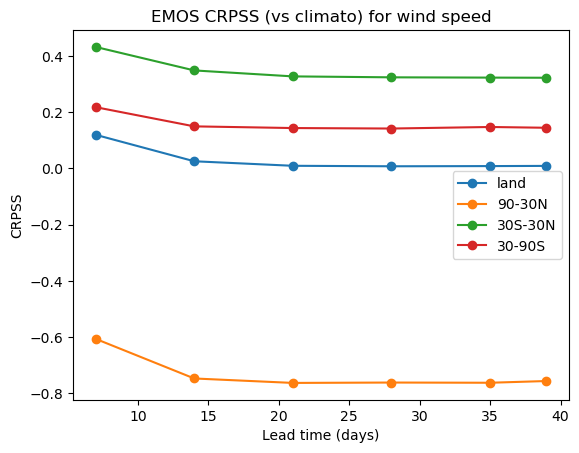

In [197]:
crpss_emos_wind = weight_latitude_zone(1, emos_wind_crpss_ds, type="crpss")
for key in crpss_emos_wind:
    plt.plot(lead_times, crpss_emos_wind[key], label=key, marker='o')
plt.title("EMOS CRPSS (vs climato) for wind speed")
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.legend()
plt.show()

### DRUnet

Best temp: ds5 et ds9
Best wind: ds2 et ds3

In [36]:
def build_crpss_map_time_avg_lat(ds_arr, ds_arr_clim, variable, mask, W, lat_range): # weight here because different format
    W = W.sel(latitude=slice(lat_range[0], lat_range[1]))
    return 1 - (ds_arr[f"crps_{variable}"].groupby('lead_time').mean(dim='time') * mask).sel(latitude=slice(lat_range[0], lat_range[1])).weighted(W).mean(dim=('latitude', 'longitude')) / (ds_arr_clim * mask).sel(latitude=slice(lat_range[0], lat_range[1])).weighted(W).mean(dim=('latitude', 'longitude'))

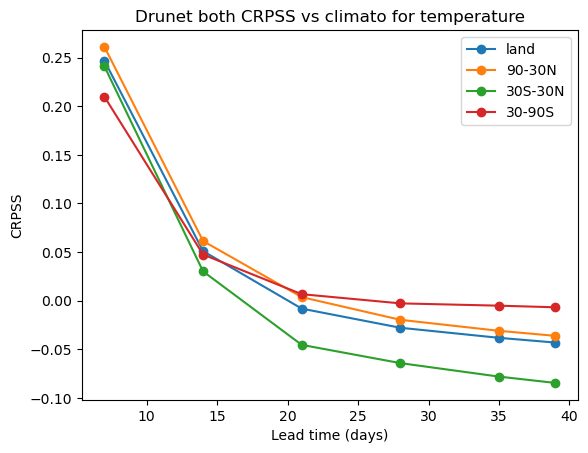

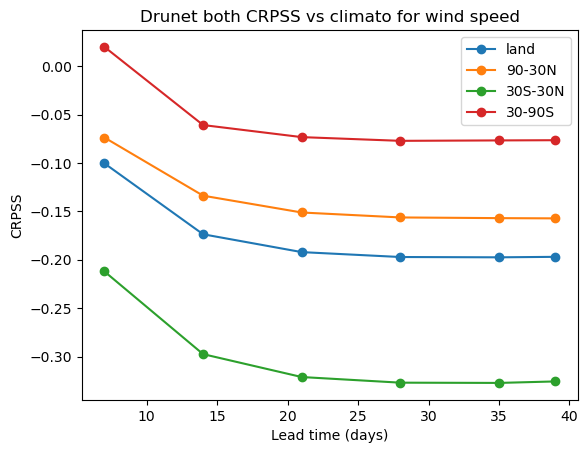

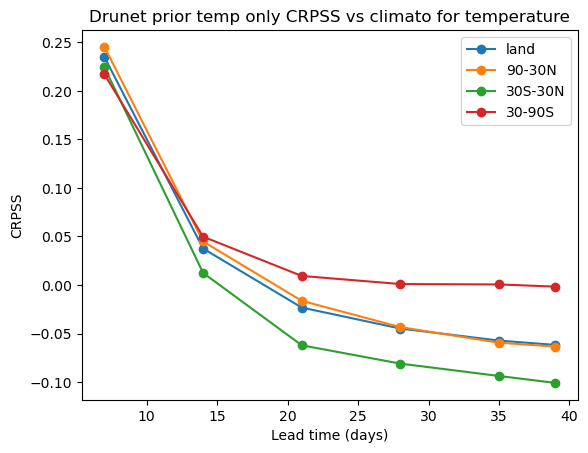

In [41]:
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds5, clim_temp_ds_unet, "temperature", land_sea_mask, weights, [-90, 90]), label="land", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds5, clim_temp_ds_unet, "temperature", land_sea_mask, weights, [30, 90]), label="90-30N", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds5, clim_temp_ds_unet, "temperature", land_sea_mask, weights, [-30, 30]), label="30S-30N", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds5, clim_temp_ds_unet, "temperature", land_sea_mask, weights, [-90, -30]), label="30-90S", marker='o')
plt.title("Drunet both CRPSS vs climato for temperature")
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.legend()
plt.show()

plt.plot(lead_times, build_crpss_map_time_avg_lat(ds5, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [-90, 90]), label="land", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds5, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [30, 90]), label="90-30N", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds5, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [-30, 30]), label="30S-30N", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds5, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [-90, -30]), label="30-90S", marker='o')
plt.title("Drunet both CRPSS vs climato for wind speed")
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.legend()
plt.show()

# ds9 
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds9, clim_temp_ds_unet, "temperature", land_sea_mask, weights, [-90, 90]), label="land", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds9, clim_temp_ds_unet, "temperature", land_sea_mask, weights, [30, 90]), label="90-30N", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds9, clim_temp_ds_unet, "temperature", land_sea_mask, weights, [-30, 30]), label="30S-30N", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds9, clim_temp_ds_unet, "temperature", land_sea_mask, weights, [-90, -30]), label="30-90S", marker='o')
plt.title("Drunet prior temp only CRPSS vs climato for temperature")
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.legend()
plt.show()




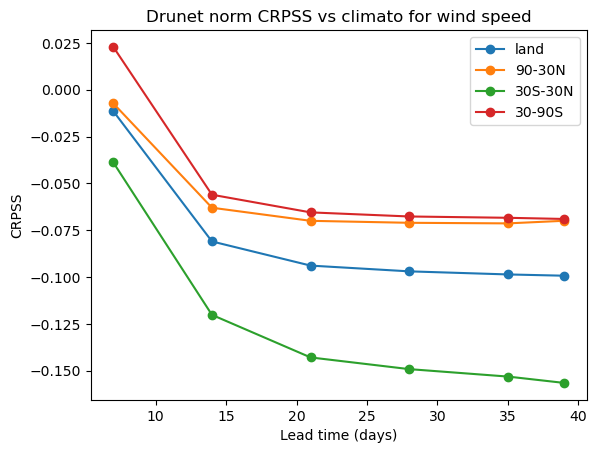

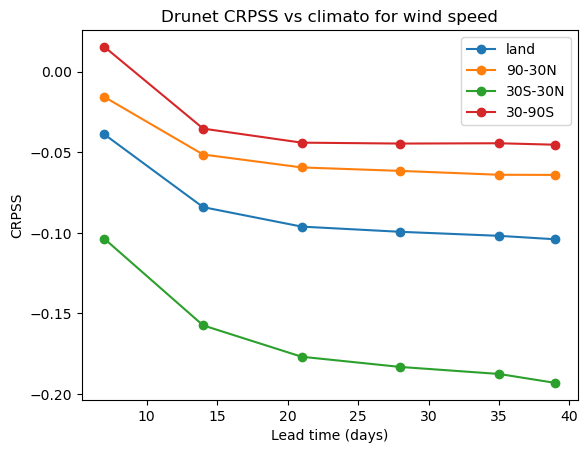

In [43]:
# ds 3 fo wind
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds3, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [-90, 90]), label="land", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds3, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [30, 90]), label="90-30N", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds3, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [-30, 30]), label="30S-30N", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds3, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [-90, -30]), label="30-90S", marker='o')
plt.title("Drunet norm CRPSS vs climato for wind speed")
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.legend()
plt.show()

# ds 2 for wind
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds2, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [-90, 90]), label="land", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds2, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [30, 90]), label="90-30N", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds2, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [-30, 30]), label="30S-30N", marker='o')
plt.plot(lead_times, build_crpss_map_time_avg_lat(ds2, clim_wind_ds_unet, "wind_speed", land_sea_mask, weights, [-90, -30]), label="30-90S", marker='o')
plt.title("Drunet CRPSS vs climato for wind speed")
plt.xlabel("Lead time (days)")
plt.ylabel("CRPSS")
plt.legend()
plt.show()



In [42]:
# # DRUnet old version
# plt.plot(lead_times, (crpss_temp_ds*land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label="land", marker='o')
# plt.plot(lead_times, (crpss_temp_ds*land_sea_mask).sel(latitude=slice(30, 90)).weighted(weights.sel(latitude=slice(30, 90))).mean(dim=('latitude', 'longitude')), label="90-30N", marker='o')
# plt.plot(lead_times, (crpss_temp_ds*land_sea_mask).sel(latitude=slice(-30, 30)).weighted(weights.sel(latitude=slice(-30, 30))).mean(dim=('latitude', 'longitude')), label="30S-30N", marker='o')
# plt.plot(lead_times, (crpss_temp_ds*land_sea_mask).sel(latitude=slice(-90, -30)).weighted(weights.sel(latitude=slice(-90, -30))).mean(dim=('latitude', 'longitude')), label="30-90S", marker='o')
# plt.plot(lead_times, (crpss_temp_ds*land_sea_mask).sel(latitude=slice(-60, 60)).weighted(weights.sel(latitude=slice(-60, 60))).mean(dim=('latitude', 'longitude')), label="60N-60S", marker='o')
# plt.title("DRUnet CRPSS (vs climato) for temperature")
# plt.xlabel("Lead time (days)")
# plt.ylabel("CRPSS")
# plt.legend()
# plt.show()

# plt.plot(lead_times, (crpss_wind_ds*land_sea_mask).weighted(weights).mean(dim=('latitude', 'longitude')), label="land", marker='o')
# plt.plot(lead_times, (crpss_wind_ds*land_sea_mask).sel(latitude=slice(30, 90)).weighted(weights.sel(latitude=slice(30, 90))).mean(dim=('latitude', 'longitude')), label="90-30N", marker='o')
# plt.plot(lead_times, (crpss_wind_ds*land_sea_mask).sel(latitude=slice(-30, 30)).weighted(weights.sel(latitude=slice(-30, 30))).mean(dim=('latitude', 'longitude')), label="30S-30N", marker='o')
# plt.plot(lead_times, (crpss_wind_ds*land_sea_mask).sel(latitude=slice(-90, -30)).weighted(weights.sel(latitude=slice(-90, -30))).mean(dim=('latitude', 'longitude')), label="30-90S", marker='o')
# plt.plot(lead_times, (crpss_wind_ds*land_sea_mask).sel(latitude=slice(-60, 60)).weighted(weights.sel(latitude=slice(-60, 60))).mean(dim=('latitude', 'longitude')), label="60N-60S", marker='o')
# plt.title("DRUnet CRPSS (vs climato) for wind speed")
# plt.xlabel("Lead time (days)")
# plt.ylabel("CRPSS")
# plt.legend()
# plt.show()

# 2. Maps

In [52]:
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr

def plot_lead(ds, variable, model, type, lat_idx_beg=None, projection=ccrs.PlateCarree()):
    """
    Plots CRPS or CRPSS for different lead times in a 2x3 grid.

    Parameters:
    ds (xarray.Dataset): Dataset containing the CRPSS data.
    variable (str): The variable to plot (e.g., temperature).
    model (str): The model used (e.g., EMOS).
    lead_times (list): List of lead times to plot. If None, it defaults to the first 6 lead times in the dataset.
    projection (cartopy.crs): Cartopy coordinate reference system to project the data onto.
    """
    lead_times = [7, 14, 21, 28, 35, 39]  # Default lead times
    if type == "CRPSS":
        cmap='coolwarm'
        norm = plt.Normalize(vmin=-1, vmax=1)
        
    else:
        #vmin, vmax = ds.min().item(), ds.max().item()
        norm = plt.Normalize(vmin=0, vmax=5)
        cmap='viridis'

    fig, axs = plt.subplots(2, 3, figsize=(20, 10), subplot_kw={'projection': projection})
    fig.suptitle(f"{model} {type} for {variable}", fontsize=16)
    
    
    if lat_idx_beg is None:
        lon_min, lon_max = 0,358.5 #ds.longitude.min().item(), ds.longitude.max().item()
        lat_min, lat_max = -90,90 #ds.latitude.min().item(), ds.latitude.max().item()
    else:
        lon_min, lon_max = 0,358.5
        lat_min, lat_max = ds.latitude.min().item(), ds.latitude.max().item()
    print(lon_min, lon_max, lat_min, lat_max)

    for i in range(6):
        ax = axs[i//3, i%3]
        ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())
        ax.coastlines()
        if lat_idx_beg is None:
            lead_idx = lead_times[i]
        else:
            lead_idx = round(lead_times[i]/7)
        im = ax.imshow(ds.sel(lead_time=lead_idx).values, origin='lower', extent=[lon_min, lon_max+1.5, lat_min, lat_max], transform=ccrs.PlateCarree(), cmap=cmap, norm=norm)
        ax.set_title(f"Lead time {lead_times[i]} days")
        
    # Add a colorbar that spans all subplots
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
    fig.colorbar(im, cax=cbar_ax, label=type, extend='both', norm=norm)
    plt.show()
    


## CRPS

0 358.5 -90 90


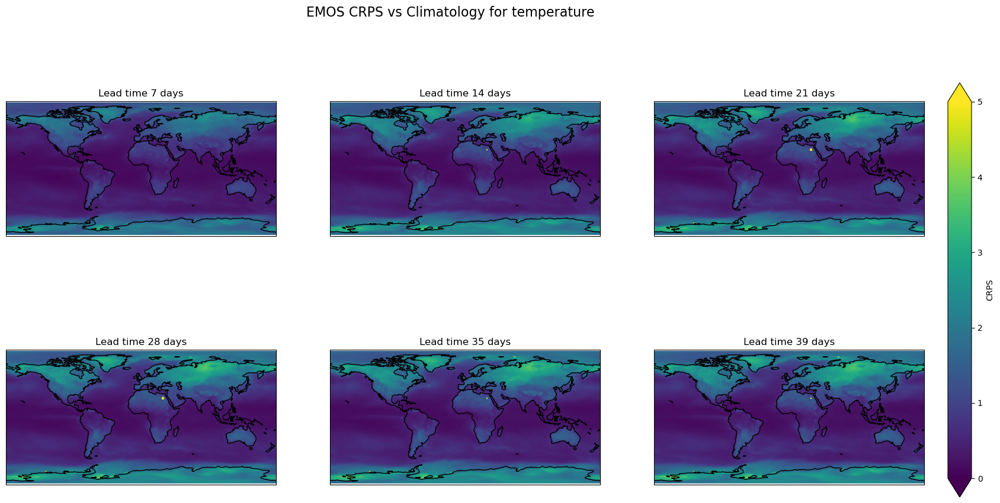

In [62]:
plot_lead(emos_temp_ds.groupby('lead_time').mean(dim='forecast_idx'), "temperature", "EMOS", type="CRPS")

0 358.5 -90 90


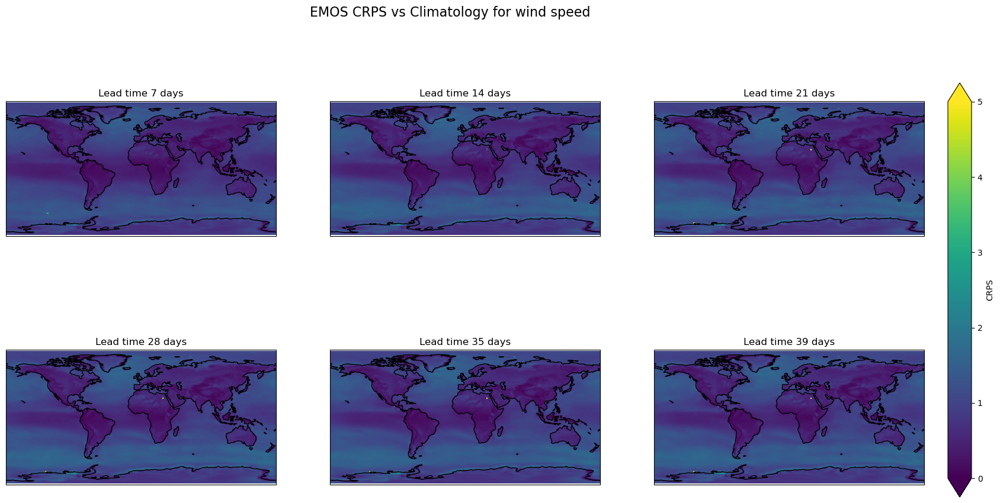

In [63]:
plot_lead(emos_wind_ds.groupby('lead_time').mean(dim='forecast_idx'), "wind speed", "EMOS", type="CRPS")

0 358.5 -88.49999999999996 90.0


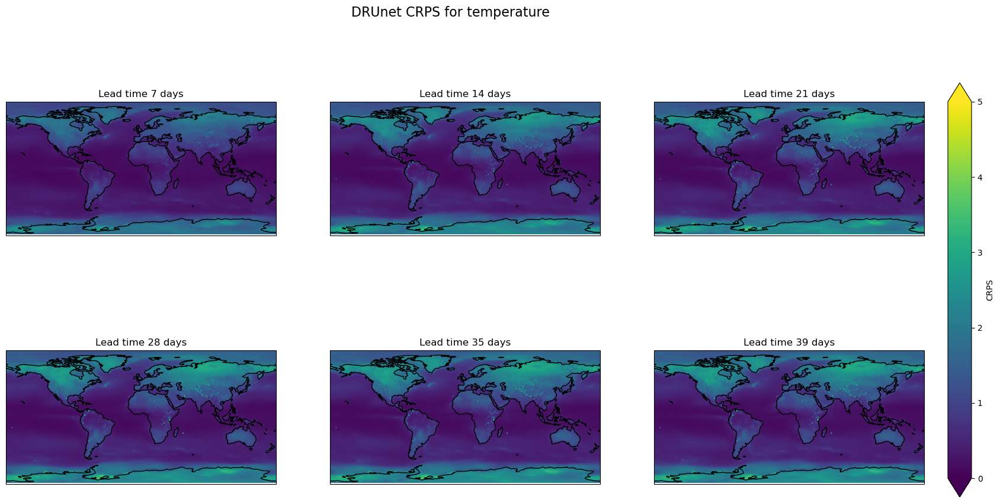

In [19]:
plot_lead(ds_lead["crps_temperature"], "temperature", "DRUnet", type="CRPS", lat_idx_beg=1)

0 358.5 -88.49999999999996 90.0


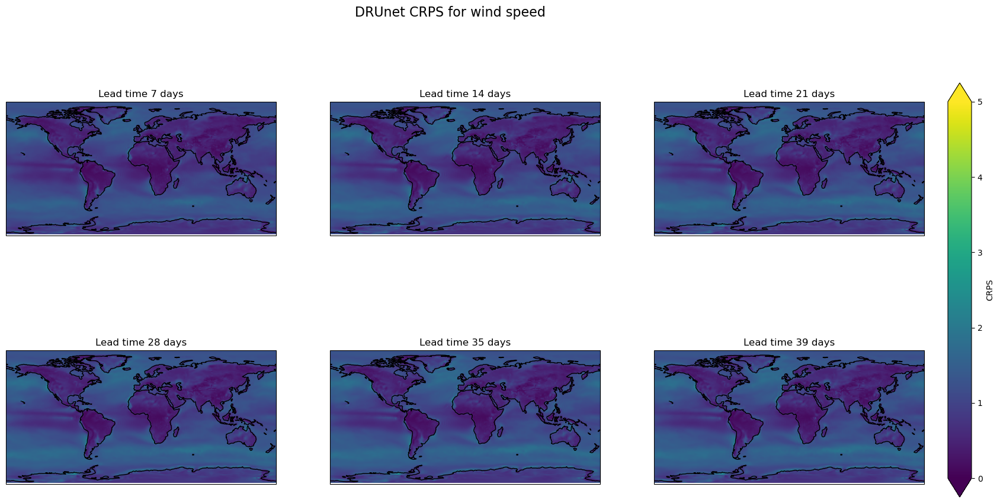

In [20]:
plot_lead(ds_lead["crps_wind_speed"], "wind speed", "DRUnet", type="CRPS", lat_idx_beg=1)

0 358.5 -88.49999999999996 90.0


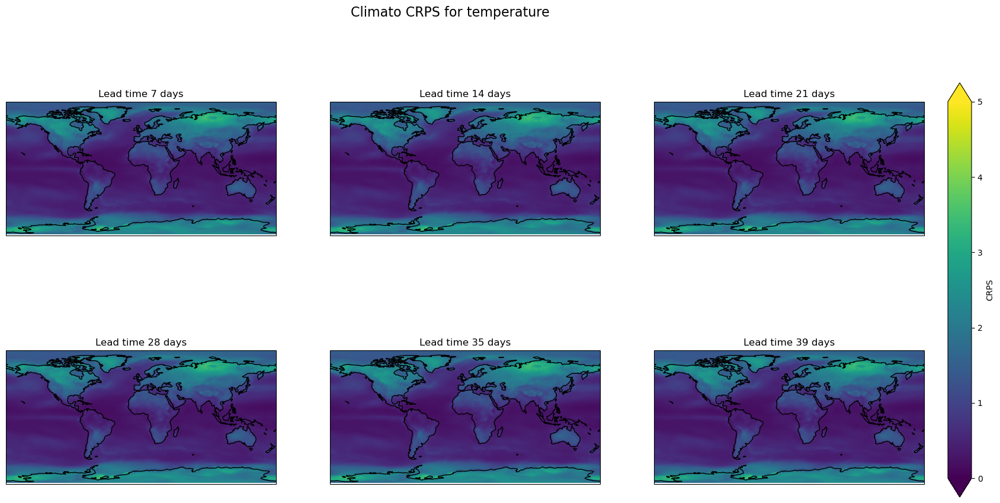

In [21]:
plot_lead(ds_lead["crps_temperature_climato"], "temperature", "Climato", type="CRPS", lat_idx_beg=1)

## CRPSS

## EMOS

0 358.5 -90 90


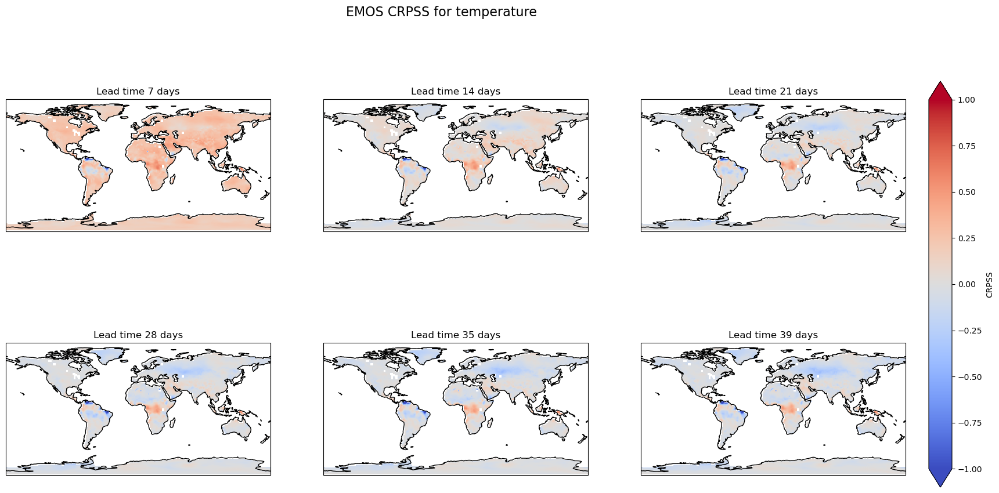

0 358.5 -90 90


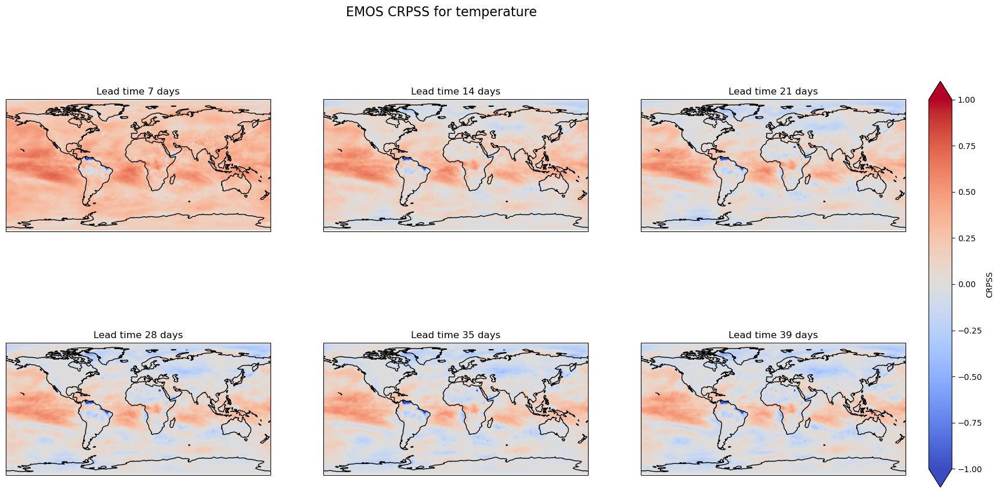

In [34]:
plot_lead(emos_temp_crpss_ds, "temperature", "EMOS", type="CRPSS") # without sea 
plot_lead(1 - (emos_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]) / (clim_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]), "temperature", "EMOS", type="CRPSS")

0 358.5 -90 90


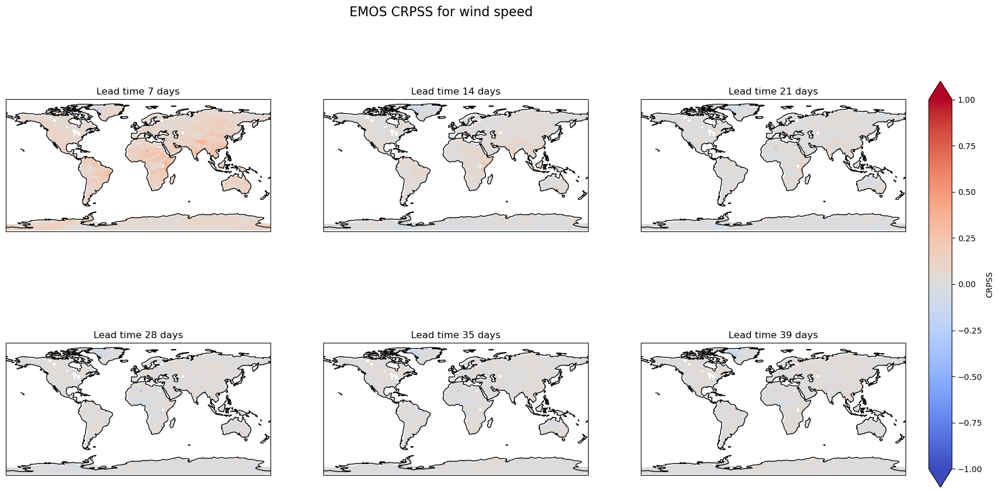

0 358.5 -90 90


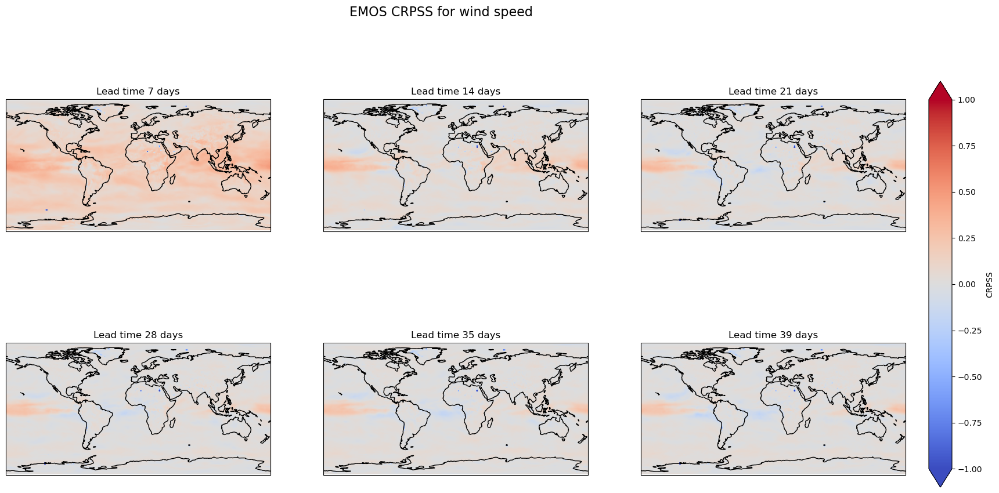

In [36]:
plot_lead(emos_wind_crpss_ds, "wind speed", "EMOS", "CRPSS")
plot_lead(1 - (emos_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:]) / (clim_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:]), "wind speed", "EMOS", "CRPSS")

## Raw

0 358.5 -90 90


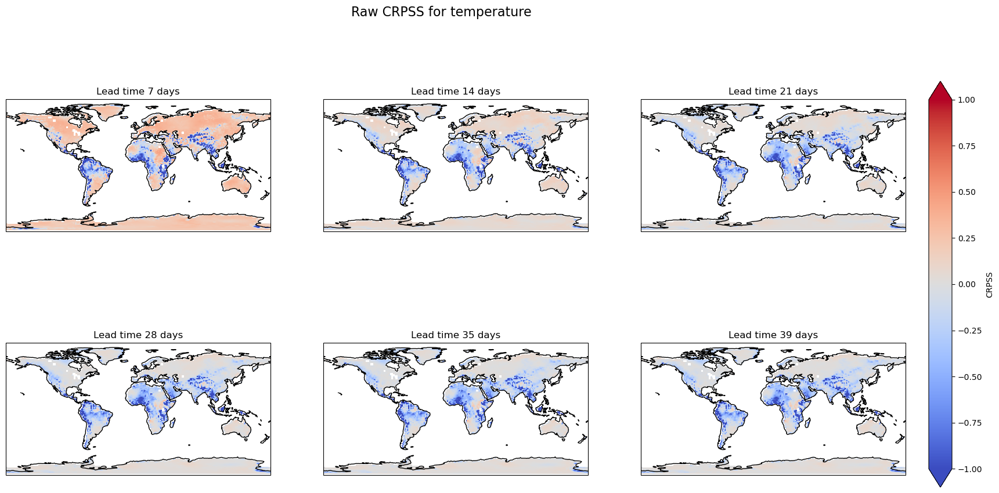

0 358.5 -90 90


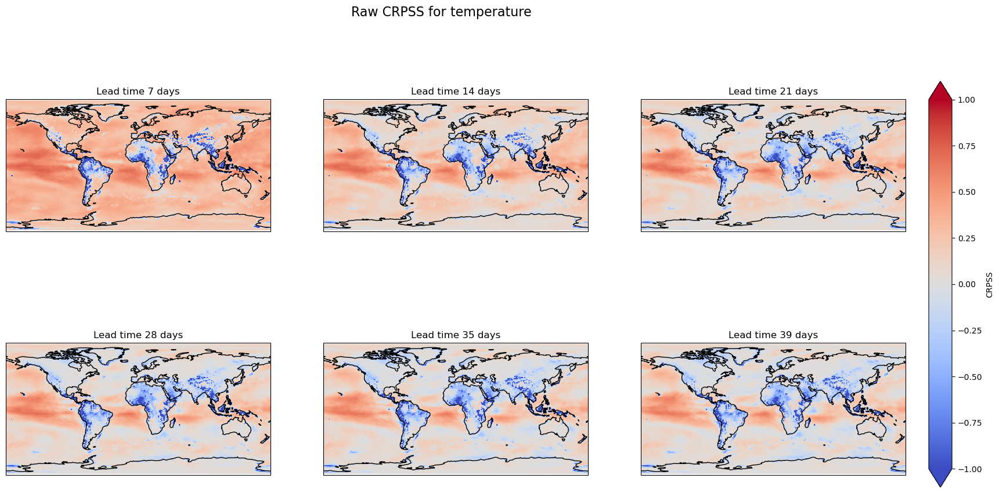

In [38]:
plot_lead(raw_temp_crpss_ds, "temperature", "Raw", "CRPSS")
plot_lead(1 - (raw_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]) / (clim_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]), "temperature", "Raw", "CRPSS")

0 358.5 -90 90


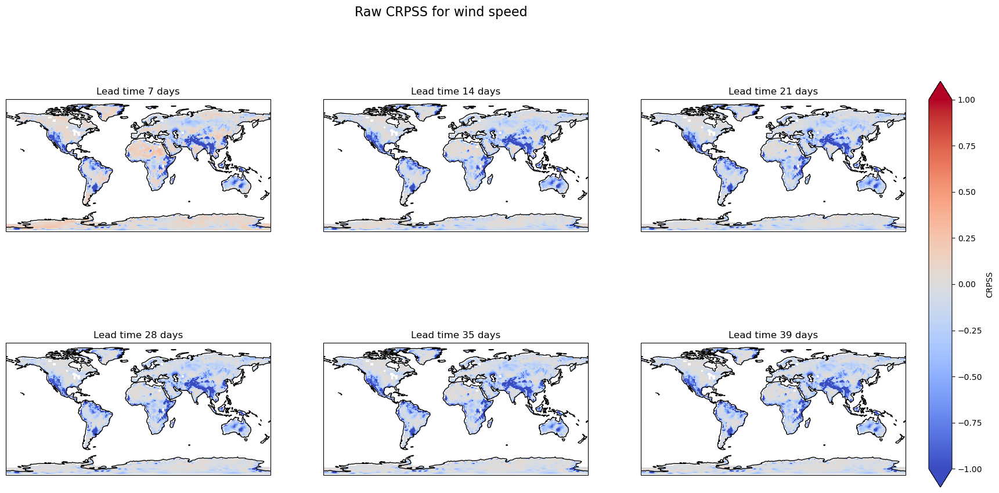

0 358.5 -90 90


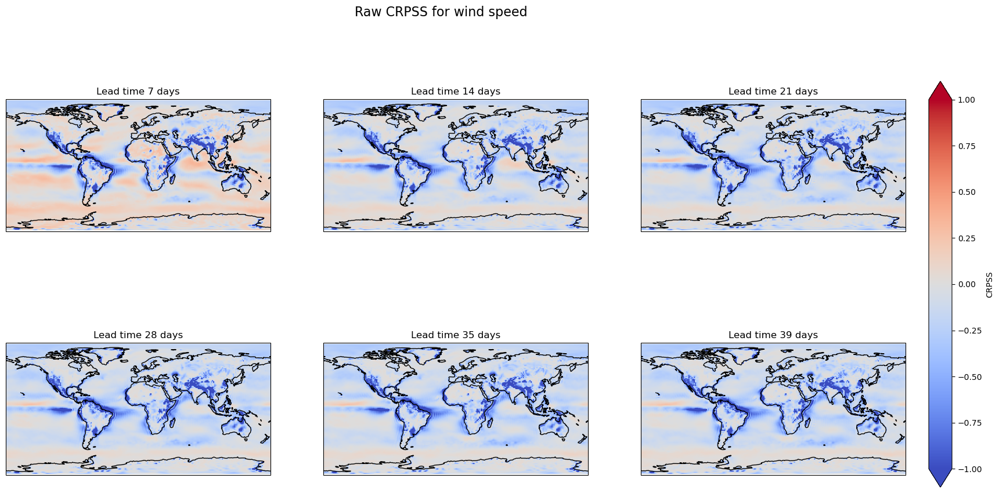

In [39]:
plot_lead(raw_wind_crpss_ds, "wind speed", "Raw", "CRPSS")
plot_lead(1 - (raw_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:]) / (clim_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:]), "wind speed", "Raw", "CRPSS")

## DRUnet

best temp : id=5 et 9
best wind: 2 et 3

In [53]:
def build_crpss_map_time_avg(ds_arr, ds_arr_clim, variable): # weight here because different format
    return 1 - (ds_arr[f"crps_{variable}"].groupby('lead_time').mean(dim='time') ) / (ds_arr_clim )

0 358.5 -88.49999999999996 90.0


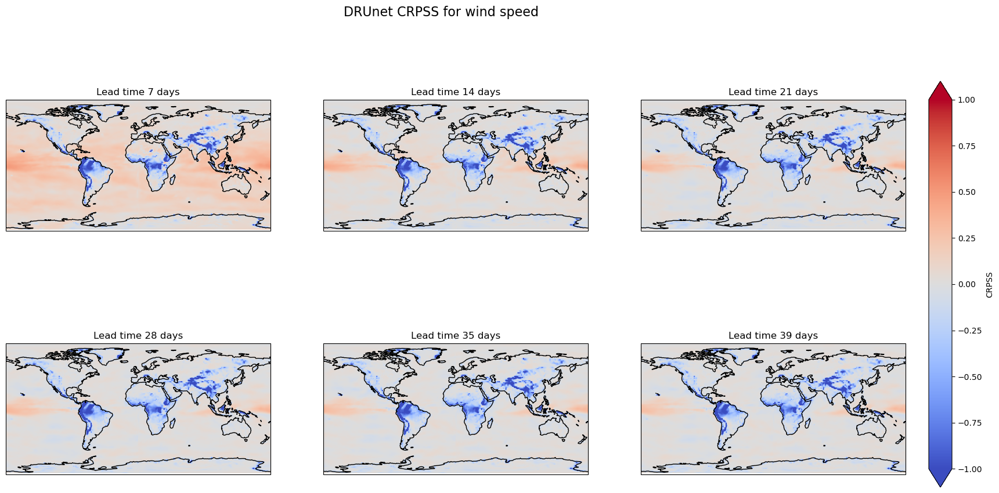

0 358.5 -88.49999999999996 90.0


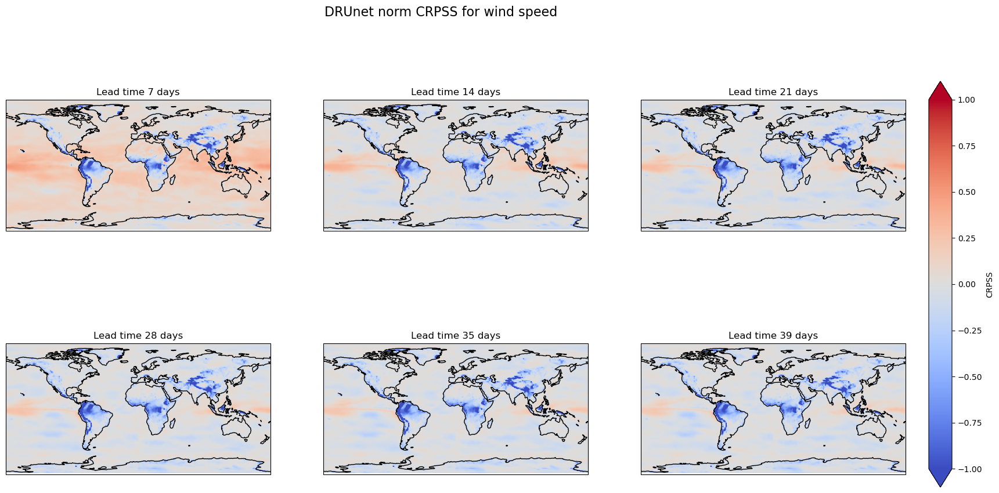

0 358.5 -88.49999999999996 90.0


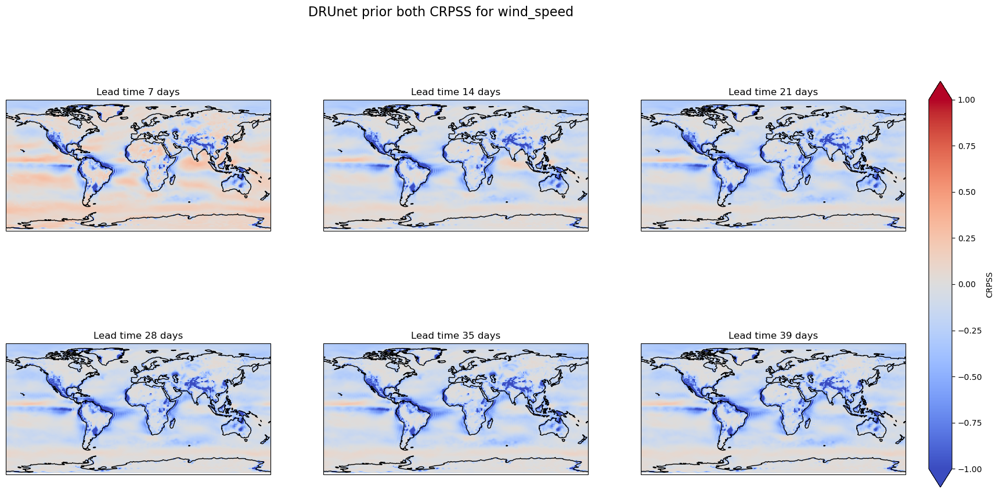

In [49]:
plot_lead(build_crpss_map_time_avg(ds2,clim_wind_ds_unet, "wind_speed"), "wind speed", "DRUnet", "CRPSS", lat_idx_beg=1)
plot_lead(build_crpss_map_time_avg(ds3,clim_wind_ds_unet, "wind_speed"), "wind speed", "DRUnet norm", "CRPSS", lat_idx_beg=1)
plot_lead(build_crpss_map_time_avg(ds5,clim_wind_ds_unet, "wind_speed"), "wind_speed", "DRUnet prior both", "CRPSS", lat_idx_beg=1)

0 358.5 -88.49999999999996 90.0


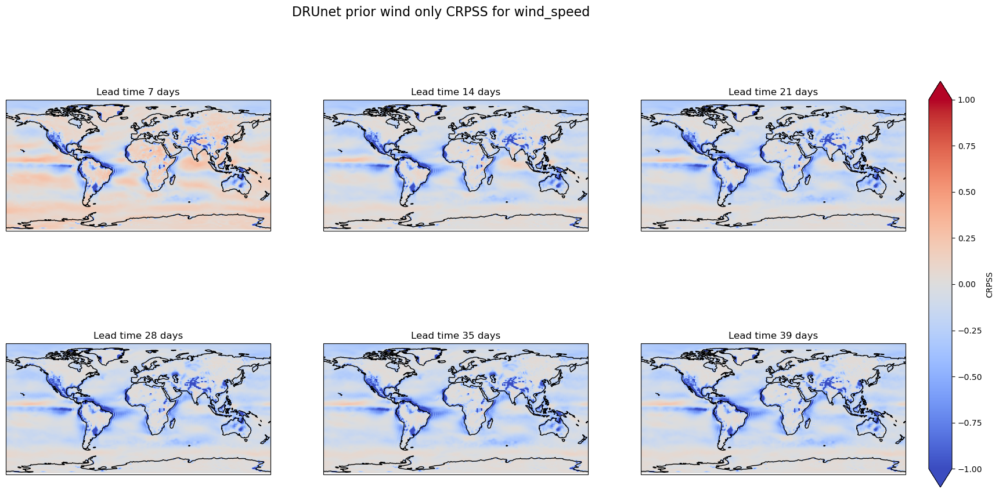

In [53]:
plot_lead(build_crpss_map_time_avg(ds8,clim_wind_ds_unet, "wind_speed"), "wind_speed", "DRUnet prior wind only", "CRPSS", lat_idx_beg=1)

0 358.5 -88.49999999999996 90.0


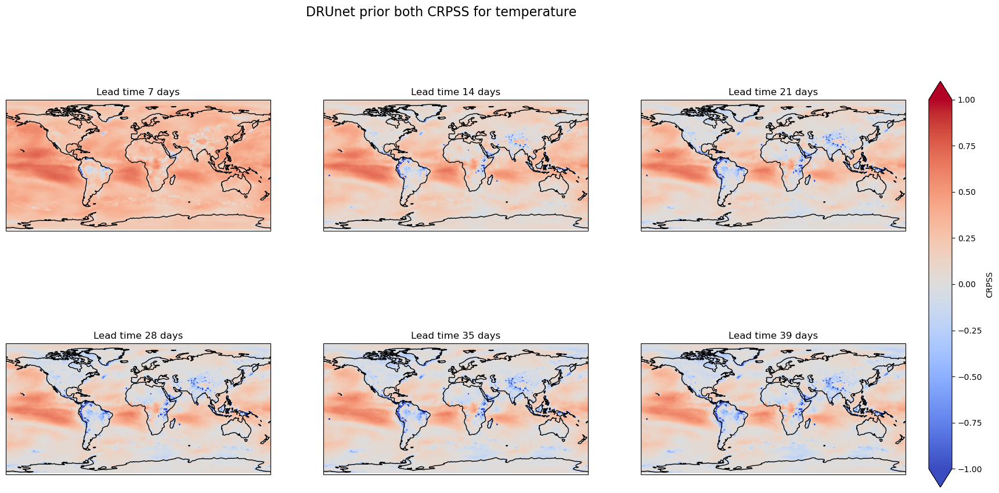

0 358.5 -88.49999999999996 90.0


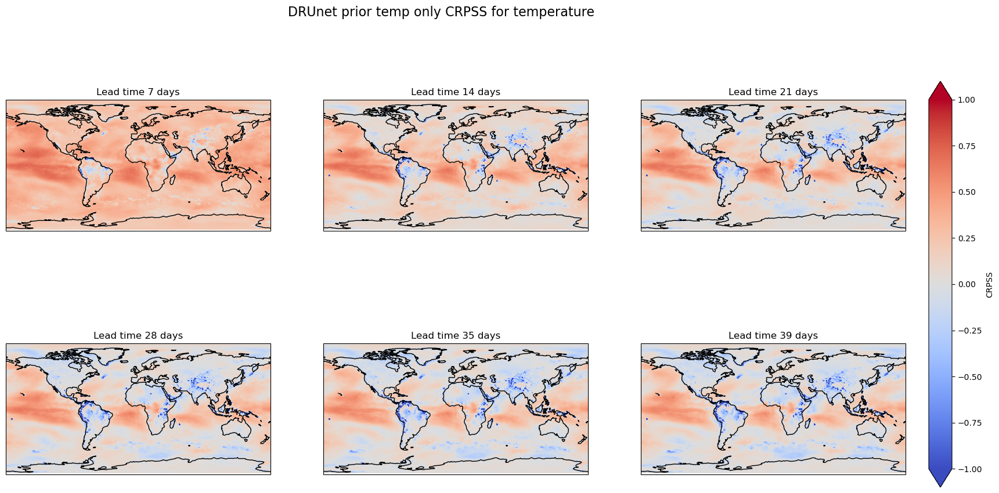

In [51]:
plot_lead(build_crpss_map_time_avg(ds5, clim_temp_ds_unet, "temperature"), "temperature", "DRUnet prior both", "CRPSS", lat_idx_beg=1)
plot_lead(build_crpss_map_time_avg(ds9, clim_temp_ds_unet, "temperature"), "temperature", "DRUnet prior temp only", "CRPSS", lat_idx_beg=1)

In [56]:
ds_list_temp = [
    1 - (raw_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]) / (clim_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]),
    1 - (emos_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]) / (clim_temp_ds.mean(dim='forecast_idx')[:,lat_beg:,:]),
    build_crpss_map_time_avg(ds3,clim_temp_ds_unet, "temperature"),
    build_crpss_map_time_avg(ds5,clim_temp_ds_unet, "temperature"),
    build_crpss_map_time_avg(ds9,clim_temp_ds_unet, "temperature"),
]

ds_list_wind = [
    1 - (raw_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:]) / (clim_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:]),
    1 - (emos_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:]) / (clim_wind_ds.mean(dim='forecast_idx')[:,lat_beg:,:]),
    #build_crpss_map_time_avg(ds3,clim_wind_ds_unet, "wind_speed"), # both
    build_crpss_map_time_avg(ds5,clim_wind_ds_unet, "wind_speed"), #both+prior
    build_crpss_map_time_avg(ds8,clim_wind_ds_unet, "wind_speed"), # prior single 
    #build_crpss_map_time_avg(ds12,clim_wind_ds_unet, "wind_speed"), # single+
]

0
1
2
3


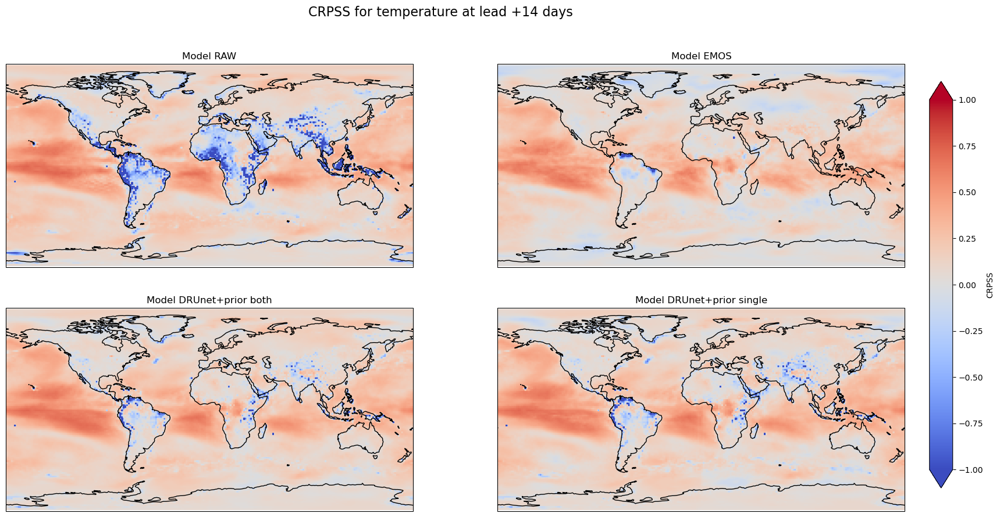

In [55]:
# everyone lead 14 
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr

def plot_lead14(ds_list, variable, model, type, lat_idx_beg=None, projection=ccrs.PlateCarree()):
    """
    Plots CRPS or CRPSS for different lead times in a 2x3 grid.

    Parameters:
    ds (xarray.Dataset): Dataset containing the CRPSS data.
    variable (str): The variable to plot (e.g., temperature).
    model (str): The model used (e.g., EMOS).
    lead_times (list): List of lead times to plot. If None, it defaults to the first 6 lead times in the dataset.
    projection (cartopy.crs): Cartopy coordinate reference system to project the data onto.
    """
    lead_times = 14  # Default lead times
    if type == "CRPSS":
        cmap='coolwarm'
        norm = plt.Normalize(vmin=-1, vmax=1)
        
    else:
        #vmin, vmax = ds.min().item(), ds.max().item()
        norm = plt.Normalize(vmin=0, vmax=5)
        cmap='viridis'

    if variable == "temperature":
        fig, axs = plt.subplots(2, 2, figsize=(20, 10), subplot_kw={'projection': projection})
    else: 
        fig, axs = plt.subplots(2, 2, figsize=(20, 10), subplot_kw={'projection': projection})
    fig.suptitle(f"{type} for {variable} at lead +{lead_times} days", fontsize=16)
    
    
    if lat_idx_beg is None:
        lon_min, lon_max = 0,358.5 #ds.longitude.min().item(), ds.longitude.max().item()
        lat_min, lat_max = -90,90 #ds.latitude.min().item(), ds.latitude.max().item()
    else:
        lon_min, lon_max = 0,358.5
        lat_min, lat_max = ds.latitude.min().item(), ds.latitude.max().item()

    for i, ds in enumerate(ds_list):
        print(i)
        ax = axs[i//2, i%2]
        ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())
        ax.coastlines()
        # if lat_idx_beg is None:
        #     lead_idx = lead_times
        # else:
        #     lead_idx = round(lead_times/7)
        im = ax.imshow(ds.isel(lead_time=1).values, origin='lower', extent=[lon_min, lon_max+1.5, lat_min, lat_max], transform=ccrs.PlateCarree(), cmap=cmap, norm=norm)
        ax.set_title(f"Model {model[i]}")
        
    # Add a colorbar that spans all subplots
    # add color bar above horizontal
    #cbar_ax = fig.add_axes([0.15, 0.92, 0.7, 0.02])  # [left, bottom, width, height]
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
    fig.colorbar(im, cax=cbar_ax, label=type, extend='both', norm=norm)
    plt.show()
    



plot_lead14(ds_list_temp[:2]+ds_list_temp[3:], "temperature", ["RAW","EMOS", "DRUnet+prior both", "DRUnet+prior single"], type="CRPSS")

0
1
2
3


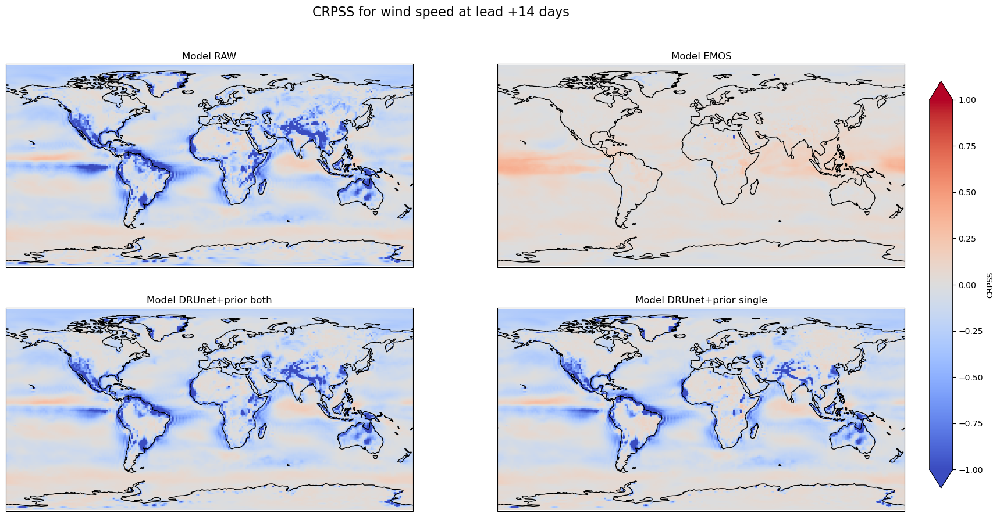

In [57]:
plot_lead14(ds_list_wind, "wind speed", ["RAW","EMOS", "DRUnet+prior both", "DRUnet+prior single"], type="CRPSS")

In [60]:
# utils 
def plot_map(lats, lons, data, name, cmap='viridis', norm=None):
    plt.figure(figsize=(20, 5))
    buffer = 0.01
    ax = plt.axes(projection=ccrs.PlateCarree())
    # Calculate extent with buffer to avoid identical limits
    lon_min, lon_max = lons.min(), lons.max()
    lat_min, lat_max = lats.min(), lats.max()
    extent = [lon_min, lon_max, lat_min, lat_max ]

    
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    ax.coastlines()
    
    # Plot data
    if norm:
        im = ax.imshow(data, origin='lower', extent=[lon_min, lon_max+1.5, lat_min, lat_max], transform=ccrs.PlateCarree(), cmap=cmap, norm=norm)
    else:
        im = ax.imshow(data, origin='lower', extent=[lon_min, lon_max+1.5, lat_min, lat_max], transform=ccrs.PlateCarree(), cmap=cmap)


    plt.colorbar(im, label=name, extend='both')
    ax.gridlines(draw_labels=True)
    plt.show()

def compute_crpss(crps, crps_clim):
    return 1 - np.array(crps) / np.array(crps_clim)
    

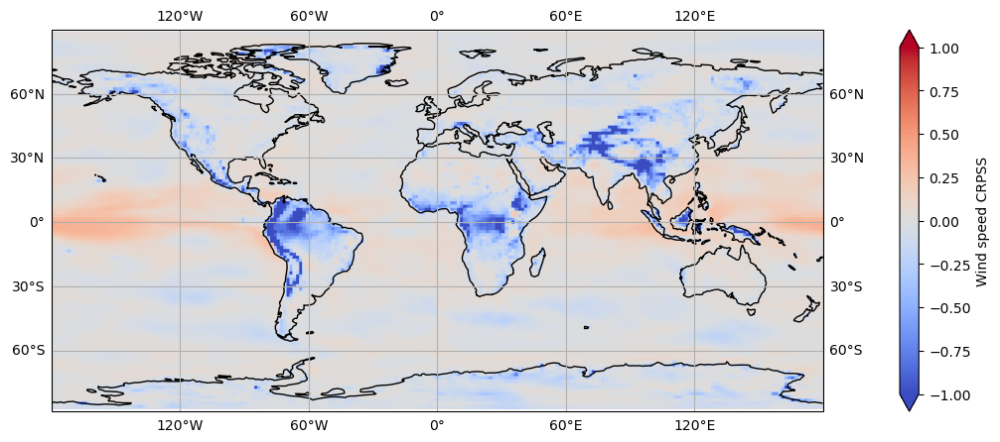

In [60]:
plot_map(ds_list_wind[2].latitude, ds_list_wind[2].longitude, np.clip(ds_list_wind[2].isel(lead_time=1), -1, 1), "Wind speed CRPSS", cmap="coolwarm", norm = plt.Normalize(vmin=-1, vmax=1))

# 3. Mean and std

In [35]:
from processings.dataset import WeatherDataset, WeatherEnsembleDataset, WeatherEnsembleDatasetMMdetrend, WeatherYearEnsembleDataset
from torch.utils.data import DataLoader
from model import SpatialMOS, SpatialEMOS , SpatialEMOSprior, DRUnet, SpatialEMOSMM, DRUnetPrior
from metrics import compute_crps_normal, crps_normal
from sklearn.metrics import root_mean_squared_error
import torch
from torch.distributions import Normal
from processings.format_data import compute_wind_speedxr
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os

In [67]:
# EMOS detrend
def compute_inference_detrend(variable, train_index, month, lead_time, name_exp, id, projection=ccrs.PlateCarree(), date=None):
    index2month = {1: "January", 2: "February", 3: "March", 4: "April", 5: "May", 6: "June", 7: "July", 8: "August", 9: "September", 10: "October", 11: "November", 12: "December"}
    base_dir = f"training_results/{name_exp}/lead{lead_time}"
    data_folder = "/home/majanvie/scratch/data" 
    test_folder = f"{data_folder}/test/EMOS"
    obs_folder = f"{data_folder}/raw/obs"
    climato_folder = f"{obs_folder}/climato"
    train_years = [1996, 2017]
    if variable == "2m_temperature":
        epoch = 9
    elif variable == "10m_wind_speed":
        epoch = 14
    valid_years = [2018,2022]

    model_folder = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead_time}"
    climato_path = f"{climato_folder}/{variable}_{train_years[0]}_{train_years[-1]}_month{month}_lead{lead_time}.nc"
    climato = xr.open_dataset(climato_path)

    test_dataset = WeatherEnsembleDatasetMMdetrend(
        data_path=test_folder,
        obs_path=obs_folder,
        target_variable=variable,
        lead_time_idx=lead_time,
        valid_years=valid_years,
        valid_months=[month,month],
        subset="test")
    #print(len(test_dataset.data_index))
    test_loader = DataLoader(test_dataset, batch_size=1, shuffle=True)

    # load model weights
    model = SpatialEMOSMM(67, 121, 240, 4)
    model.load_state_dict(torch.load(
        f"{model_folder}/model_{epoch}.pth"
        ))
    model.eval()

    # Compute performance metrics
    m_list = []
    std_list =[]
    crps_list = []
    rmse_list = []
    for batch in test_loader:
        mu = batch['mu']
        sigma = batch['sigma']
        X = batch['input']
        y = batch['truth']
        valid_time = batch['valid_time']
        print(valid_time)
        #print(date)
        if valid_time[0] == date:
            valid_date = pd.to_datetime(valid_time).strftime('%m-%d')
            out_distrib= model(mu, sigma, X, y)

            mu_clim = torch.tensor(climato["mu"].sel(date=valid_date).values[0])
            sigma_clim = torch.tensor(climato["sigma"].sel(date=valid_date).values[0])
            climato_distrib = Normal(mu_clim, sigma_clim)

            if variable == "2m_temperature":
                Xt = pd.to_datetime(valid_time).astype(np.int64)[0] * 1e-9
                #print("shape", y.shape)
                #print(y.mean())
                trend = test_dataset.trend_model_truth.predict(Xt.reshape(-1,1)).reshape(240,121).T
                #plot_map(test_dataset.latitude, test_dataset.longitude, trend, "trend")
                #print("pred detrended", out_distrib.loc.mean())
                out_distrib.loc += torch.tensor(trend, dtype=out_distrib.loc.dtype)
            
            # get mean, std of distrib 
            mean = out_distrib.loc #.reshape(121*240).reshape(240,121).T
            std = out_distrib.scale
            #out_distrib.loc = out_distrib.loc.reshape(121*240).reshape(240,121).T

            #print(mean.shape, std.shape)

            #print("pred", out_distrib.loc.mean())
            #print("diff", (y-out_distrib.loc).mean())
            crps_var = crps_normal(out_distrib,y).detach().numpy()  # shape (1, lat, lon)
            crps_climato = crps_normal(climato_distrib,y).detach().numpy() # shape (1, lat, lon)
            #plot_map(test_dataset.latitude, test_dataset.longitude, crps_var[0], "CRPS")
            #plot_map(test_dataset.latitude, test_dataset.longitude, crps_climato[0], "CRPS climato")
            plot_map(test_dataset.latitude, test_dataset.longitude, mean[0].detach().numpy(), f"Mean Temperature (K)", title=f" EMOS Mean Temperature (K) {valid_time}, lead 14 days")
            #plot_map(test_dataset.latitude, test_dataset.longitude, mean[0].detach().numpy().reshape(121*240).reshape(240,121).T, "mean")
            plot_map(test_dataset.latitude, test_dataset.longitude, np.clip(std[0].detach().numpy(), 0,10), f"Std Temperature (K)", title=f"EMOS Std Temperature (K) {valid_time}, lead 14 days", norm=plt.Normalize(vmin=0, vmax=10))
            #plot_map(test_dataset.latitude, test_dataset.longitude, mean[0].detach().numpy(), "Mean ", norm = plt.Normalize(vmin=0, vmax=14))
            #plot_map(test_dataset.latitude, test_dataset.longitude, np.clip(std[0].detach().numpy(), 0,10), f"Std Temperature (K)", norm=plt.Normalize(vmin=0, vmax=6))


            break
        #rmse = root_mean_squared_error(y[0].detach().numpy(), mean[0].detach().numpy(), multioutput='raw_values')
    #     rmse = np.abs(y[0].detach().numpy() - mean[0].detach().numpy())
    #     m_list.append(mean)
    #     std_list.append(std)
    #     rmse_list.append(rmse)
        
    #     crps_var = compute_crps_normal(model, batch).detach().numpy()  # shape (1, lat, lon)
    #     crps_list.append(crps_var)
    #     break 
    # return m_list, std_list, rmse_list, crps_list, test_dataset
    

['2020-01-23']
['2022-01-10']
['2022-01-13']
['2018-01-29']
['2021-01-28']
['2018-01-04']


['2019-01-14']
['2018-01-08']
['2022-01-24']
['2019-01-17']
['2019-01-21']
['2018-01-15']
['2020-01-06']
['2021-01-25']
['2021-01-21']
['2020-01-30']
['2018-01-22']
['2020-01-02']
['2018-01-25']
['2022-01-20']
['2021-01-18']
['2022-01-06']
['2019-01-10']
['2022-01-27']
['2021-01-07']
['2022-01-17']
['2022-01-31']
['2022-01-03']
['2019-01-24']
['2020-01-13']
['2020-01-27']
['2018-01-18']
['2020-01-09']
['2021-01-11']
features tensor(-4.4256) tensor(21.3312)
sigma tensor(0.0935) tensor(7.0942)
mu tensor(-12.7830) tensor(6.5243)
sigma tensor(0.0896, grad_fn=<MinBackward1>) tensor(9.2152, grad_fn=<MaxBackward1>)
log tensor(-2.3700) tensor(1.9593)
a tensor(-2.9768, grad_fn=<MinBackward1>) tensor(1.5920, grad_fn=<MaxBackward1>)
b tensor(-3.7169, grad_fn=<MinBackward1>) tensor(7.2511, grad_fn=<MaxBackward1>)
c tensor(-0.8031, grad_fn=<MinBackward1>) tensor(1.2061, grad_fn=<MaxBackward1>)
d tensor(-1.5273, grad_fn=<MinBackward1>) tensor(2.1658, grad_fn=<MaxBackward1>)


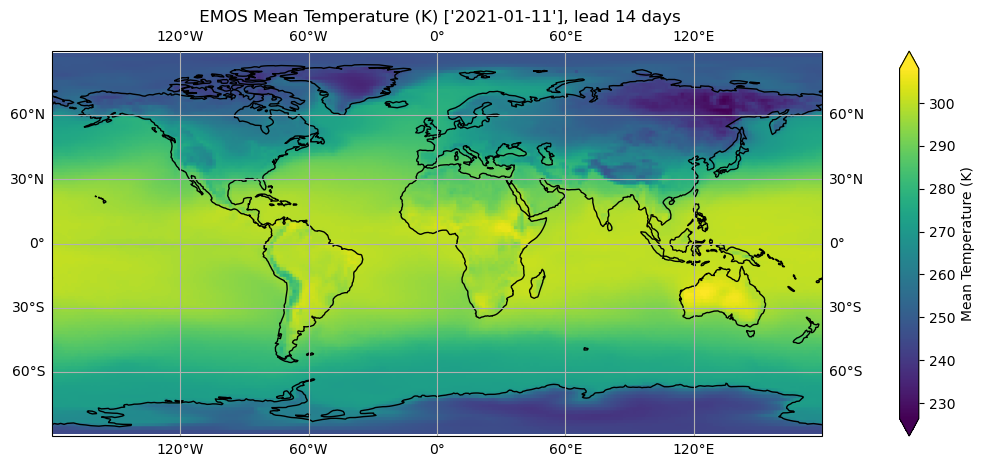

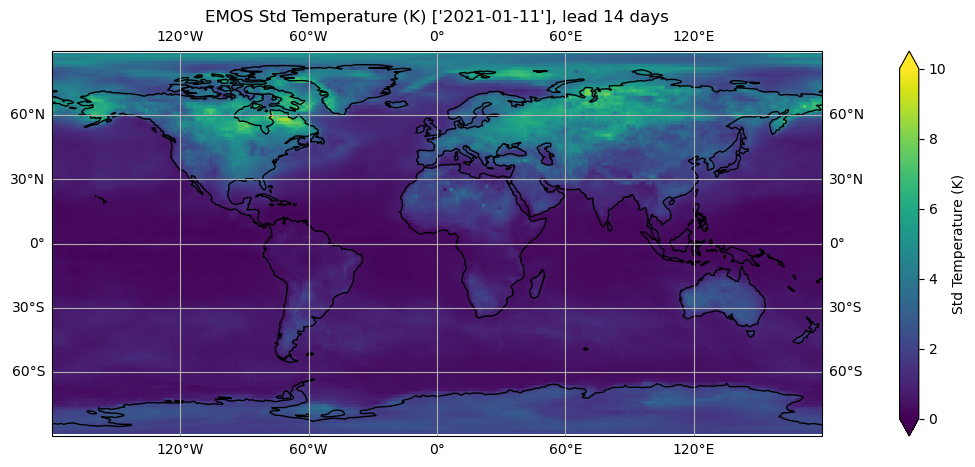

In [68]:
compute_inference_detrend("2m_temperature", 1, 1, 14, "spatial_month_ensemble_detrend_temp", 1, date="2021-01-11")

['2021-08-02']
['2022-08-08']
['2021-08-19']
['2018-08-23']
['2020-08-20']
['2019-08-19']
['2022-08-11']
['2019-08-26']
['2019-08-15']
['2022-08-15']
['2020-08-27']
['2018-08-16']
['2019-08-22']
['2020-08-13']
['2021-08-30']
['2020-08-31']
['2022-08-04']
['2021-08-12']
['2020-08-10']
['2021-08-23']
['2018-08-27']
['2021-08-26']
['2021-08-09']
['2019-08-01']
['2018-08-09']
['2022-08-29']
['2021-08-05']
['2018-08-06']
['2020-08-06']
['2022-08-18']
['2019-08-08']
['2020-08-03']
['2018-08-13']
['2018-08-02']
['2022-08-01']
['2021-08-16']
['2019-08-05']
features tensor(-4.8154) tensor(18.8279)
sigma tensor(0.0949) tensor(8.3503)
mu tensor(-10.5786) tensor(10.5573)
sigma tensor(0.1036, grad_fn=<MinBackward1>) tensor(60.0898, grad_fn=<MaxBackward1>)
log tensor(-2.3554) tensor(2.1223)
a tensor(-2.1508, grad_fn=<MinBackward1>) tensor(2.2653, grad_fn=<MaxBackward1>)
b tensor(-3.3346, grad_fn=<MinBackward1>) tensor(6.5538, grad_fn=<MaxBackward1>)
c tensor(-1.6550, grad_fn=<MinBackward1>) tensor(1

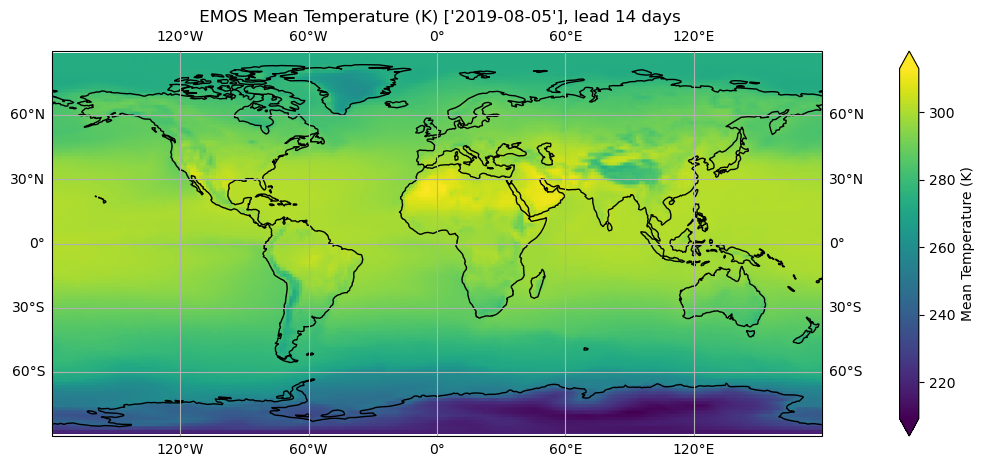

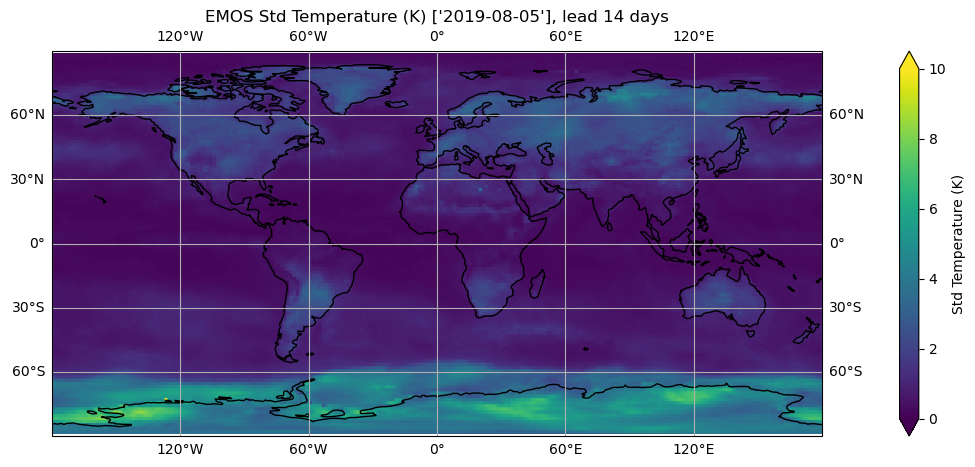

In [69]:
compute_inference_detrend("2m_temperature", 8, 8, 14, "spatial_month_ensemble_detrend_temp", 1, date="2019-08-05")

['2018-01-11']
['2018-01-18']
['2021-01-28']
['2021-01-07']
['2022-01-20']
['2021-01-18']
['2021-01-11']
features tensor(-4.4256) tensor(21.3312)
sigma tensor(0.0598) tensor(4.7100)
mu tensor(0.1283) tensor(15.1143)
sigma tensor(0.0407, grad_fn=<MinBackward1>) tensor(34.5601, grad_fn=<MaxBackward1>)
log tensor(-2.8172) tensor(1.5497)
a tensor(-0.4121, grad_fn=<MinBackward1>) tensor(2.9613, grad_fn=<MaxBackward1>)
b tensor(-0.2015, grad_fn=<MinBackward1>) tensor(7.0086, grad_fn=<MaxBackward1>)
c tensor(-0.6998, grad_fn=<MinBackward1>) tensor(0.9500, grad_fn=<MaxBackward1>)
d tensor(-2.2476, grad_fn=<MinBackward1>) tensor(2.8603, grad_fn=<MaxBackward1>)


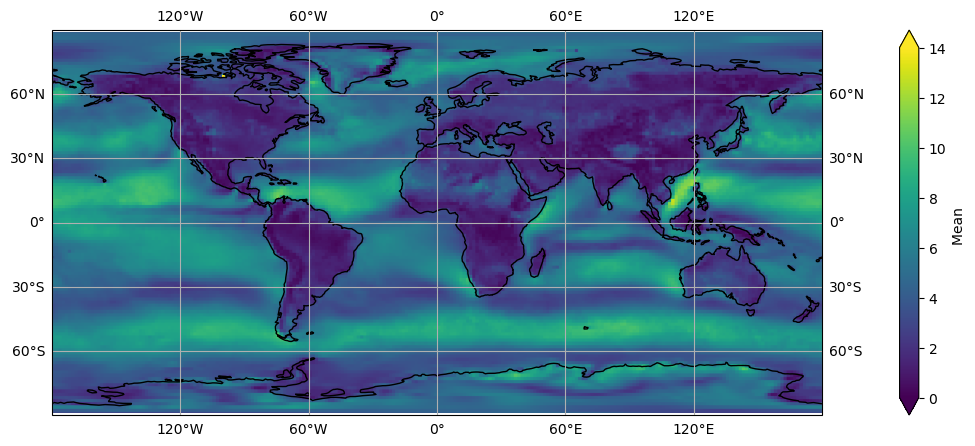

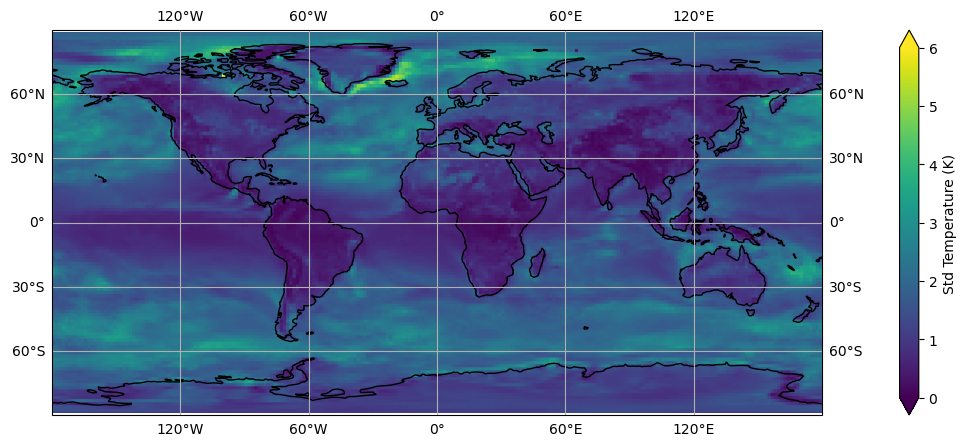

In [64]:
#compute_inference_detrend("2m_temperature", 1, 1, 14, "spatial_month_ensemble_detrend_temp", 1)
compute_inference_detrend("10m_wind_speed", 2, 1, 14, "spatial_month_ensemble_detrend", 1, date="2021-01-11")

In [54]:
# DRUnet

def compute_inference_DRUnet(train_index, epoch, date, lead, name_special=None, projection=ccrs.PlateCarree()):
    train_years = [1996, 2017]
    valid_years = [2018,2022]
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    data_folder = "/home/majanvie/scratch/data" 
    test_folder = f"{data_folder}/test/EMOS"
    # TODO build climato 
    obs_folder = f"{data_folder}/raw/obs"
    climato_folder = f"{obs_folder}/climato"

    base_dir = f"training_results/DRUnet"

    if name_special is None:
        model_folder = f"{base_dir}/training_{train_index}_DRUnet"
    else:
        model_folder = f"{base_dir}/training_{train_index}_DRUnet_{name_special}"
    climato_path = f"{climato_folder}/{train_years[0]}_{train_years[-1]}.nc"
    climato = xr.open_dataset(climato_path)
    # directement recuperer la ground truth dans le fichier 
    era = xr.open_mfdataset(f"{obs_folder}/*.nc", combine='by_coords')
    compute_wind_speedxr(era, "obs")

    test_dataset = WeatherYearEnsembleDataset(
        data_path=test_folder,
        obs_path=obs_folder,
        valid_years=valid_years,
        subset="test")
    #print(pd.to_datetime(x[3]), float(date.split("-")[1]))
    test_dataset.data_index = [x for x in test_dataset.data_index
                if pd.to_datetime(x[3]).month == float(date.split("-")[1])]
    test_dataset.data_index = [x for x in test_dataset.data_index
                if x[-1] == lead]
    #print("test dataset", len(test_dataset))

    print("test dataset", len(test_dataset))

    test_loader = DataLoader(test_dataset, batch_size=1, shuffle=True) #, num_workers=16)
    lat_beg = test_dataset.latitude_beg
    print(lat_beg)

    # load model weights
    model = DRUnetPrior(74,4).to(device)
    model.load_state_dict(torch.load(
        f"{model_folder}/model_{epoch}.pth", map_location=torch.device('cpu')
        ))
    model.eval()

    # Compute performance metrics
    results = []
    i = 0
    for batch in test_loader:
        X = batch['input'].to(device)
        #print(X.shape)
        y = batch['truth'].to(device)
        lead_time = batch['lead_time'].item()
        #print(lead_time)
        #print(lead_time)
        if lead_time == lead:
            # climatology
            #print(lead_time)
            valid_time = batch['valid_time']
            #print(valid_time[0][:-9])
            if valid_time[0][:-9] == date:
                print(valid_time)
                day_of_year = batch["day_of_year"]
                mu = batch['mu'].to(device)
                sigma = batch['sigma'].to(device)
                #valid_date = pd.to_datetime(valid_time).strftime('%m-%d')
                mu_clim_temp = torch.tensor(climato["2m_temperature_mean"].sel(dayofyear=day_of_year).values[0]).T[lat_beg:,:] 
                sigma_clim_temp = torch.tensor(climato["2m_temperature_std"].sel(dayofyear=day_of_year).values[0]).T[lat_beg:,:] 
                mu_clim_wind = torch.tensor(climato["10m_wind_speed_mean"].sel(dayofyear=day_of_year).values[0]).T[lat_beg:,:]
                sigma_clim_wind = torch.tensor(climato["10m_wind_speed_std"].sel(dayofyear=day_of_year).values[0]).T[lat_beg:,:] 

                # model inference
                maps, out_distrib_temp, out_distrib_wind = model(X, mu, sigma)
                print(out_distrib_temp.loc.shape)

                truth = era.sel(time=valid_time) 
                #print(truth["2m_temperature"].values.transpose(0,2,1).shape)
                y_temp = torch.Tensor(truth["2m_temperature"].values.transpose(0,2,1))[:,lat_beg:,:].to(device)
                y_wind = torch.Tensor(truth["10m_wind_speed"].values.transpose(0,2,1))[:,lat_beg:,:].to(device)


                # add trend temperature (trend y)
                Xt = pd.to_datetime(valid_time).astype(np.int64)[0] * 1e-9
                trend = test_dataset.trend_model_truth.predict(Xt.reshape(-1,1)).reshape(1, 240, 121).transpose(0,2,1)[:,lat_beg:,:]
                #y_temp += torch.tensor(trend, dtype=y_temp.dtype).to(device)
                out_distrib_temp.loc += torch.tensor(trend, dtype=out_distrib_temp.loc.dtype).to(device)

                plot_map(test_dataset.latitude[1:], test_dataset.longitude, out_distrib_temp.loc[0][:,:].detach().numpy(), "Mean Temperature (K)", title=f"DRUnet+prior both Mean Temperature (K) [{valid_time[0][:-9]}]")
                plot_map(test_dataset.latitude[1:], test_dataset.longitude, out_distrib_temp.scale[0][:,:].detach().numpy(), "Std Temperature (K)", title=f"DRUnet+prior both Std Temperature (K) [{valid_time[0][:-9]}]")
                # wind
                plot_map(test_dataset.latitude[1:], test_dataset.longitude, out_distrib_wind.loc[0][:,:].detach().numpy(), "Mean Wind Speed (m/s)", title=f"DRUnet+prior both Mean Wind Speed (m/s) [{valid_time[0][:-9]}]")
                plot_map(test_dataset.latitude[1:], test_dataset.longitude, out_distrib_wind.scale[0][:,:].detach().numpy(), "Std Wind Speed (m/s)", title=f"DRUnet+prior both Std Wind Speed (m/s) [{valid_time[0][:-9]}]")

                # diff with truth
                # plot_map(test_dataset.latitude[1:], test_dataset.longitude, (y_temp-out_distrib_temp.loc)[0][:,:].detach().numpy(), "Diff Temperature (K)", cmap="coolwarm", norm=plt.Normalize(vmin=-15, vmax=15))
                # plot_map(test_dataset.latitude[1:], test_dataset.longitude, (y_wind-out_distrib_wind.loc)[0][:,:].detach().numpy(), "Diff Wind Speed (m/s)", cmap="coolwarm", norm=plt.Normalize(vmin=-10, vmax=10))

                # climato_distrib_temp = Normal(mu_clim_temp.to(device), sigma_clim_temp.to(device))
                # climato_distrib_wind = Normal(mu_clim_wind.to(device), sigma_clim_wind.to(device))

                # crps_temp = crps_normal(out_distrib_temp,y_temp).cpu().detach().numpy()  # shape (1, lat, lon)
                # crps_wind = crps_normal(out_distrib_wind,y_wind).cpu().detach().numpy()
                # crps_climato_temp = crps_normal(climato_distrib_temp,y_temp).cpu().detach().numpy() # shape (1, lat, lon)
                # crps_climato_wind = crps_normal(climato_distrib_wind,y_wind).cpu().detach().numpy()

                # crpss_temp = compute_crpss(crps_temp, crps_climato_temp)
                # crpss_wind = compute_crpss(crps_wind, crps_climato_wind)

                # plot_map(test_dataset.latitude[1:], test_dataset.longitude, crpss_temp[0][:,:], "CRPSS Temperature", cmap="coolwarm", norm=plt.Normalize(vmin=-1, vmax=1))
                # plot_map(test_dataset.latitude[1:], test_dataset.longitude, crpss_wind[0][:,:], "CRPSS Wind Speed", cmap="coolwarm", norm=plt.Normalize(vmin=-1, vmax=1))



                #plot_map(test_dataset.latitude[21:], test_dataset.longitude, out_distrib_temp.loc[0][20:,:].detach().numpy(), f"mean temp {lead_time} {valid_time}")
                #plot_map(test_dataset.latitude, test_dataset.longitude, mean[0].detach().numpy().reshape(121*240).reshape(240,121).T, "mean")
                #plot_map(test_dataset.latitude[21:], test_dataset.longitude, out_distrib_temp.scale[0][20:,:].detach().numpy(), f"std temp {lead_time} {valid_time}")
                #plot_map(test_dataset.latitude[21:], test_dataset.longitude, out_distrib_wind.loc[0][20:,:].detach().numpy(), f"mean wind {lead_time} {valid_time}")
                #plot_map(test_dataset.latitude[21:], test_dataset.longitude, out_distrib_wind.scale[0][20:,:].detach().numpy(), f"std wind {lead_time} {valid_time}")

                # plot diff with truth
                #print(y_temp.shape, out_distrib_temp.loc.shape)
                #plot_map(test_dataset.latitude[21:], test_dataset.longitude, (y_temp-out_distrib_temp.loc)[0][20:,:].detach().numpy(), f"diff temp {lead_time} {valid_time}", cmap="coolwarm")
                #plot_map(test_dataset.latitude[21:], test_dataset.longitude, (y_wind-out_distrib_wind.loc)[0][20:,:].detach().numpy(), f"diff wind {lead_time} {valid_time}", cmap="coolwarm")
                if i == 1:
                    break
                i += 1




        # forecast_time = batch['forecast_time'][0]
        


In [32]:
#compute_inference_DRUnet(8, 5, "prior")

loading index
len index 3132
test dataset 44
1
['2021-01-11 00:00:00']
torch.Size([1, 120, 240])


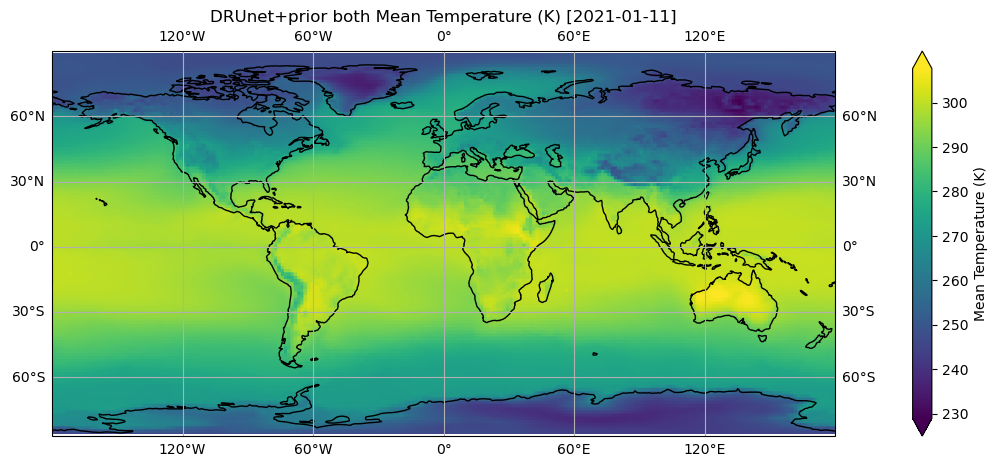

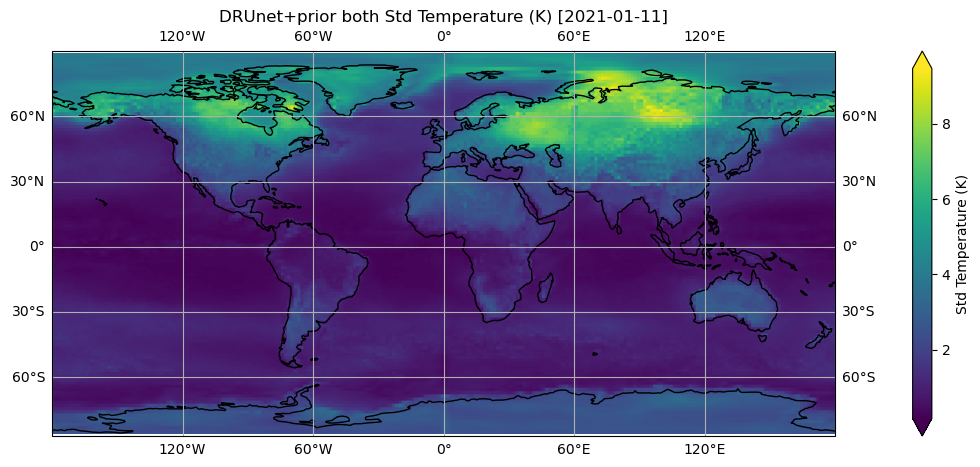

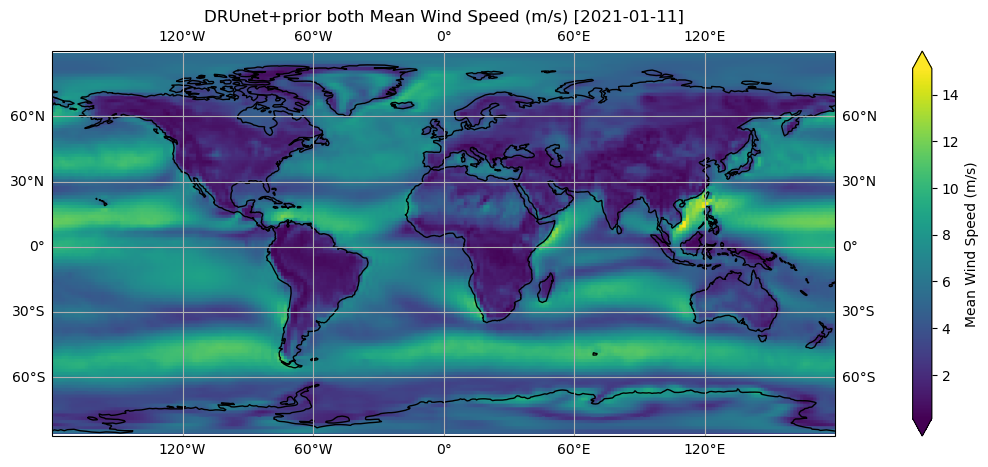

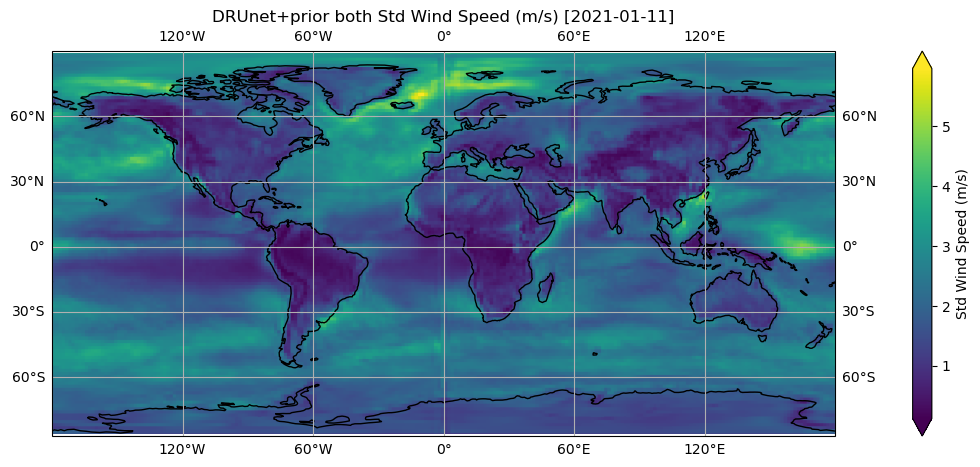

In [55]:
# DRunet+prior both 
compute_inference_DRUnet(10, 5, date="2021-01-11", lead=2, name_special="prior_both")

loading index
len index 3132
test dataset 45
1
['2019-08-05 00:00:00']
torch.Size([1, 120, 240])


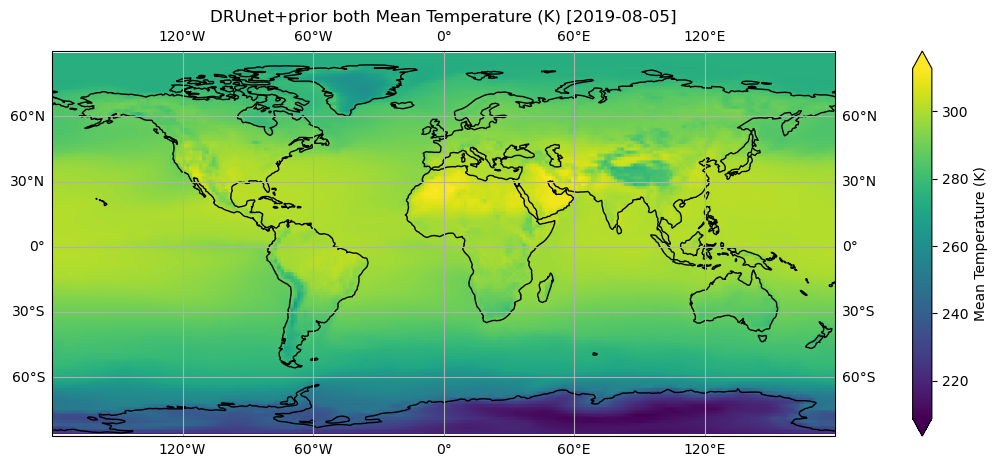

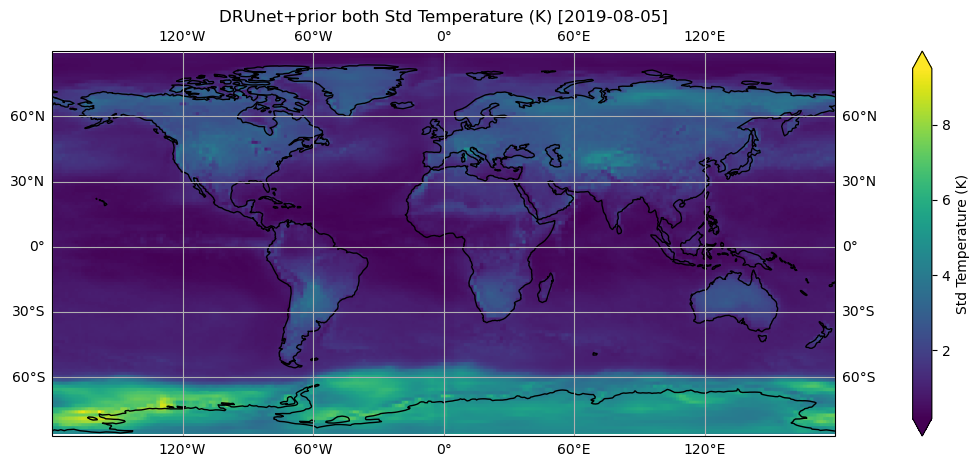

In [39]:
compute_inference_DRUnet(10, 5, date="2019-08-05", lead=2, name_special="prior_both")

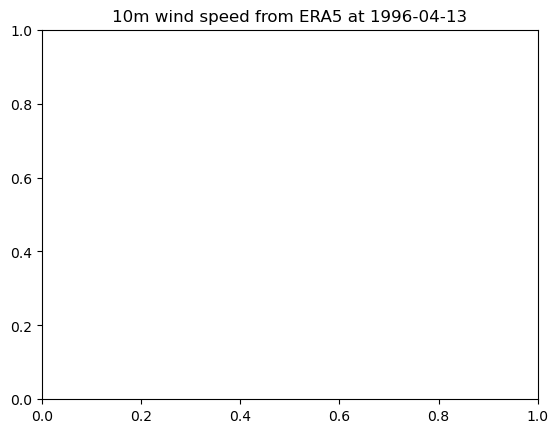

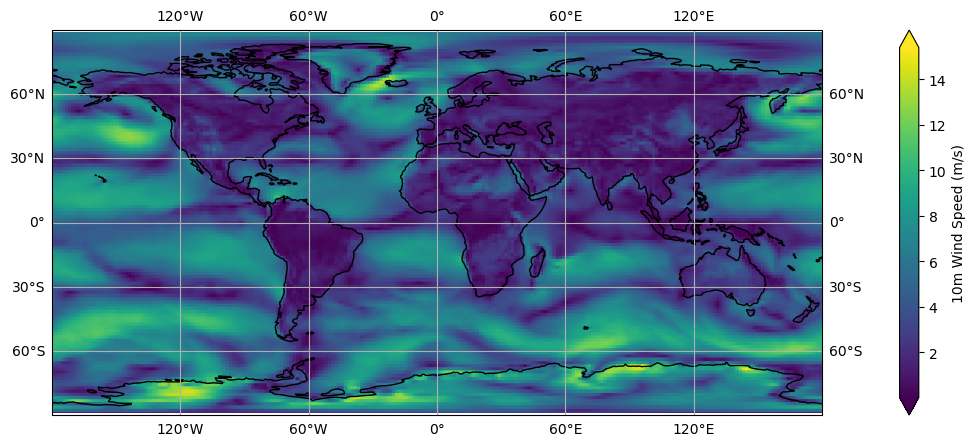

In [48]:
# era
from processings.format_data import compute_wind_speedxr
era = xr.open_mfdataset(f"{obs_folder}/*.nc", combine='by_coords')

compute_wind_speedxr(era, "obs")
plot_map(era.latitude, era.longitude, era.isel(time=100)["10m_wind_speed"].T, "10m Wind Speed (m/s)")

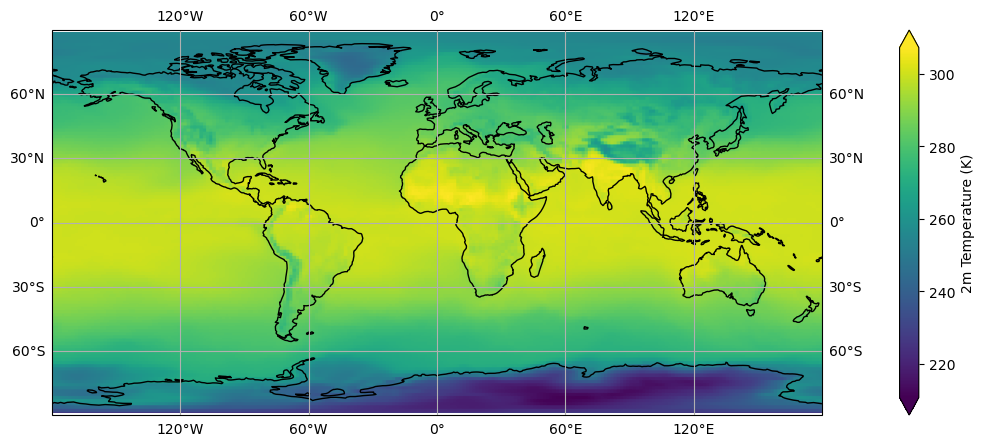

In [49]:
plot_map(era.latitude, era.longitude, era.isel(time=100)["2m_temperature"].T, "2m Temperature (K)")

['2021-01-11']
features tensor(-4.4256) tensor(21.3312)
sigma tensor(0.0935) tensor(7.0942)
mu tensor(-12.7830) tensor(6.5243)
sigma tensor(0.0896, grad_fn=<MinBackward1>) tensor(9.2152, grad_fn=<MaxBackward1>)
log tensor(-2.3700) tensor(1.9593)
a tensor(-2.9768, grad_fn=<MinBackward1>) tensor(1.5920, grad_fn=<MaxBackward1>)
b tensor(-3.7169, grad_fn=<MinBackward1>) tensor(7.2511, grad_fn=<MaxBackward1>)
c tensor(-0.8031, grad_fn=<MinBackward1>) tensor(1.2061, grad_fn=<MaxBackward1>)
d tensor(-1.5273, grad_fn=<MinBackward1>) tensor(2.1658, grad_fn=<MaxBackward1>)


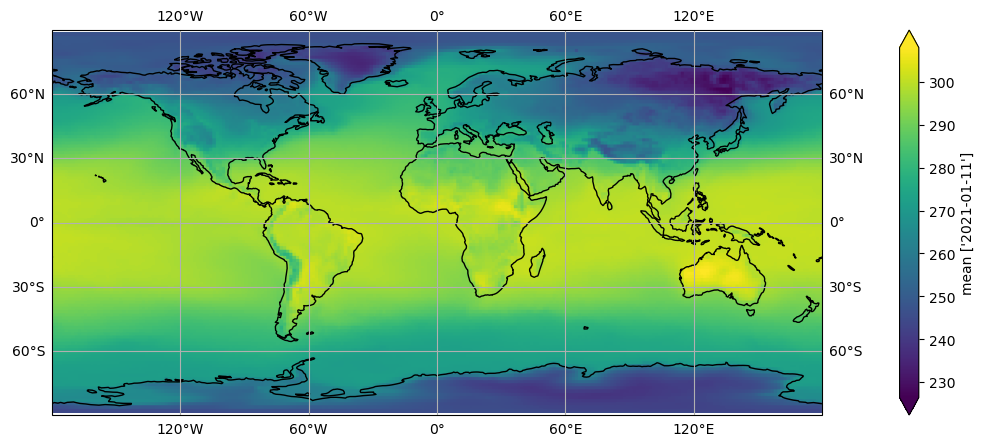

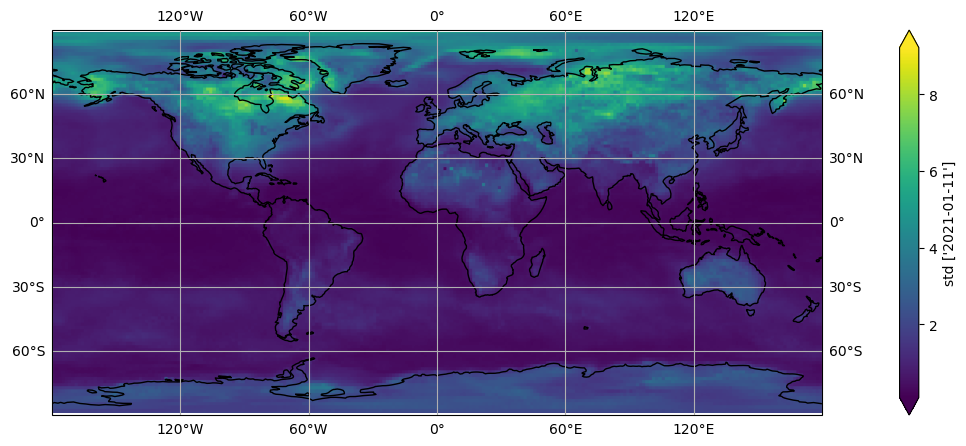

In [8]:
# figure 2021-01-11 emos detrend
name_exp = "spatial_month_ensemble_detrend_temp"
lead_time = 14
train_index = 1
month = 1
variable = "2m_temperature"

index2month = {1: "January", 2: "February", 3: "March", 4: "April", 5: "May", 6: "June", 7: "July", 8: "August", 9: "September", 10: "October", 11: "November", 12: "December"}
base_dir = f"training_results/{name_exp}/lead{lead_time}"
data_folder = "/home/majanvie/scratch/data" 
test_folder = f"{data_folder}/test/EMOS"
obs_folder = f"{data_folder}/raw/obs"
climato_folder = f"{obs_folder}/climato"
train_years = [1996, 2017]
if variable == "2m_temperature":
    epoch = 9
elif variable == "10m_wind_speed":
    epoch = 14
valid_years = [2018,2022]

model_folder = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead_time}"
climato_path = f"{climato_folder}/{variable}_{train_years[0]}_{train_years[-1]}_month{month}_lead{lead_time}.nc"
climato = xr.open_dataset(climato_path)

test_dataset = WeatherEnsembleDatasetMMdetrend(
    data_path=test_folder,
    obs_path=obs_folder,
    target_variable=variable,
    lead_time_idx=lead_time,
    valid_years=valid_years,
    valid_months=[month,month],
    subset="test")
#print(len(test_dataset.data_index))
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=True)

# load model weights
model = SpatialEMOSMM(67, 121, 240, 4)
model.load_state_dict(torch.load(
    f"{model_folder}/model_{epoch}.pth"
    ))
model.eval()

# Compute performance metrics
m_list = []
std_list =[]
crps_list = []
rmse_list = []
for batch in test_loader:
    mu = batch['mu']
    sigma = batch['sigma']
    X = batch['input']
    y = batch['truth']
    valid_time = batch['valid_time']
    if valid_time[0] == "2021-01-11":
        print(valid_time)
        valid_date = pd.to_datetime(valid_time).strftime('%m-%d')
        out_distrib= model(mu, sigma, X, y)

        mu_clim = torch.tensor(climato["mu"].sel(date=valid_date).values[0])
        sigma_clim = torch.tensor(climato["sigma"].sel(date=valid_date).values[0])
        climato_distrib = Normal(mu_clim, sigma_clim)

        if variable == "2m_temperature":
            Xt = pd.to_datetime(valid_time).astype(np.int64)[0] * 1e-9
            #print("shape", y.shape)
            #print(y.mean())
            trend = test_dataset.trend_model_truth.predict(Xt.reshape(-1,1)).reshape(240,121).T
            #plot_map(test_dataset.latitude, test_dataset.longitude, trend, "trend")
            #print("pred detrended", out_distrib.loc.mean())
            out_distrib.loc += torch.tensor(trend, dtype=out_distrib.loc.dtype)
        
        # get mean, std of distrib 
        mean = out_distrib.loc #.reshape(121*240).reshape(240,121).T
        std = out_distrib.scale
        #out_distrib.loc = out_distrib.loc.reshape(121*240).reshape(240,121).T

        #print(mean.shape, std.shape)

        #print("pred", out_distrib.loc.mean())
        #print("diff", (y-out_distrib.loc).mean())
        crps_var = crps_normal(out_distrib,y).detach().numpy()  # shape (1, lat, lon)
        crps_climato = crps_normal(climato_distrib,y).detach().numpy() # shape (1, lat, lon)
        #plot_map(test_dataset.latitude, test_dataset.longitude, crps_var[0], "CRPS")
        #plot_map(test_dataset.latitude, test_dataset.longitude, crps_climato[0], "CRPS climato")
        plot_map(test_dataset.latitude, test_dataset.longitude, mean[0].detach().numpy(), f"mean {valid_time}")
        #plot_map(test_dataset.latitude, test_dataset.longitude, mean[0].detach().numpy().reshape(121*240).reshape(240,121).T, "mean")
        plot_map(test_dataset.latitude, test_dataset.longitude, std[0].detach().numpy(), f"std {valid_time}")
        break
    #rmse = root_mean_squared_error(y[0].detach().numpy(), mean[0].detach().numpy(), multio
